In [3]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import cvlib
from pprint import pprint
import matplotlib.pyplot as plt

In [4]:
def view(img):
    k = 5
    fig,ax1 = plt.subplots(figsize=(k,k))
    if len(img.shape)==2:
        ax1.imshow(img, vmin=0, vmax=255, cmap='gray')
    else:
        ax1.imshow(img)   
    plt.axis('off')
    plt.show()

In [5]:
kernel_cross = np.array([[  0, 255,  0],
                         [255, 255, 255],
                         [  0, 255,  0]], np.uint8)

In [6]:
input_filename = "LicencePlates/images3.jpg"
b = 1
dila = 1


def find_plate(input_filename, b = 1, dila = 1):
    """Detecta la placa, imprime la placa recorda y devuelve las coordenadas en la imagen de la placa

    Args:
        input_filename (_type_): _description_
        b (int, optional): _description_. Defaults to 1.
        dila (int, optional): _description_. Defaults to 1.

    Returns:
        _type_: _description_
    """
    
    print("---DETECCIÓN DE PLACA---")
    # imagen a blanco y negro 
    img_gray = cv.imread(input_filename, cv.IMREAD_GRAYSCALE)
    #cvlib.imgview(img_gray, title = "Grayscale")

    # imagen a color
    img_color = cv.imread(input_filename,cv.IMREAD_COLOR) 
    img_color = cv.cvtColor(img_color,cv.COLOR_BGR2RGB)
    #cvlib.imgview(img_color, title= "Color")

    # Blur para imagenes 
    img_blur = img_gray.copy()
    if b > 0: 
        img_blur = cv.blur(img_gray,(b,b))
        t = "Blur " + str(b)
    # cvlib.imgview(img_blur, title = t)
    # img_blur = img_gray.copy()
    # dst = cv2.GaussianBlur(src,(5,5),cv2.BORDER_DEFAULT)


    # Binarizacion 
    imgbin = cv.adaptiveThreshold(img_blur, 255,cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY_INV,11,5)
    # cvlib.imgview(imgbin, title = "Binarizacion")


    # Dilatacion
    dilateded = cv.dilate(imgbin, kernel_cross, iterations = dila)

    # Generador de contornos 
    mode = cv.RETR_TREE 
    method = [cv.CHAIN_APPROX_NONE, cv.CHAIN_APPROX_SIMPLE]
    contours, hierarchy = cv.findContours(dilateded, mode, method[1])

    # Impresion de todos los contornos
    color = (0,255,0) #(r,g,b)
    thickness = 2
    r1 = cv.cvtColor(imgbin.copy(),cv.COLOR_GRAY2RGB)
    for i in range(len(contours)):
        r1 = cv.drawContours(r1, contours, i, color, thickness)
    # cvlib.imgview(r1, title="Contornos")


    # busqueda del contorno más ajustado
    indice = 0
    extent_mayor = 0.0

    for i in range(len(contours)):
        cnt = contours[i]
        area = cv.contourArea(cnt)
        x,y,w,h = cv.boundingRect(cnt)
        rect_area = w*h
        extent = float(area)/rect_area
        # print("Extent:", extent) 

        area_imagen = img_gray.shape[0] * img_gray.shape[1]
        area_de_placa = area / area_imagen

        # contours_internos = cv.findContours(dilateded[y:y+h, x:x+w], mode, method[1])[0]
        
        if w >= h:
            if (extent > extent_mayor): #and (len(contours_internos) > 1):
                # print("Contornos internos: ",  len(contours_internos))
                # print(extent)
                indice = i
                extent_mayor = extent
        else:
            if (extent > extent_mayor) and (area_de_placa >= 0.04): #and (len(contours_internos) > 1):
                # print("Contornos internos: ",  len(contours_internos))
                indice = i
                extent_mayor = extent
                # print(extent)

    print("Cotorno más ajustado:" , indice)
    print("Extend:" , float(extent_mayor))
    # contours_internos = cv.findContours(dilateded[y:y+h, x:x+w], mode, method[1])[0]
    # print("Contornos internos: ",  len(contours_internos))


    # Impresión del contorno más ajutado
    index =  indice
    color = (0,255,0) #(r,g,b)
    thickness = 2
    # r = cv.cvtColor(imgbin.copy(),cv.COLOR_GRAY2RGB)
    r3 = img_color.copy()
    r3 = cv.drawContours(r3, contours, index, color, thickness)
    # cvlib.imgview(r, title= "Contorno de mejor ajuste")


    # Lineas 
    # cvlib.imgview(cv.Canny(img_gray, 30, 200))


    # Area de la placa sobre área de la imagen  
    area = cv.contourArea(contours[index])
    print("Area:", area)

    area_imagen = img_gray.shape[0] * img_gray.shape[1]
    print("Area Imagen:",area_imagen) 

    area_de_placa = area / area_imagen
    print("Porcentaje de la placa:", area_de_placa)

    # Corte de imagen
    x,y,w,h = cv.boundingRect(contours[index])

    cvlib.imgcmp(r3, img_color[y:y+h, x:x+w])
    # cvlib.imgview(img_color[y:y+h, x:x+w])

    return x, y, w, h

In [18]:
import os
rootdir = os.getcwd() + "\LicencePlates"
os.listdir(rootdir)
path = "LicencePlates/"

for filename in os.listdir(rootdir):
    break
    # filename = "images"+ str(i + 3) +".jpg"
    print("Filename:", filename)
    find_plate(path + filename, 1, 1)

In [16]:
# Detectar numeros
def find_numbers(input_filename):
    """_summary_

    Args:
        input_filename (_type_): _description_
    """

    x1, y1, w1, h1 = find_plate(input_filename, 1, 1)

    print("---DETECCIÓN DE NUMEROS---")
    # Lectura a color 
    img_color = cv.imread(input_filename,cv.IMREAD_COLOR) 
    img_color = cv.cvtColor(img_color,cv.COLOR_BGR2RGB)


    # Lectura en blaco y negro
    img_gray = cv.imread(input_filename, cv.IMREAD_GRAYSCALE)


    # Recorte 
    img_re = img_gray[y1:y1+h1, x1:x1+w1]
    # cvlib.imgview(img_re)

    # Recorte 
    img_re_color = img_color[y1:y1+h1, x1:x1+w1]
    # cvlib.imgview(img_re_color)

    # Histograma - Detección fondo blanco o negro
    histr = cv.calcHist([img_re],None,None,[256],[0,256])
    # cvlib.hist(img_re)

    negro = 0
    blanco = 0 
    umbral = 100 
    for i in range(len(histr)):
        if i < umbral:
            negro += histr[i][0]
        else:
            blanco+=histr[i][0]
    print("Negro:", negro, " ", "Blanco:", blanco)

    inverso = True # indica si se usará binarizacion inversa o normal 
    if (negro > blanco):
        inverso = False



    # FloodFill 
    img_flod = img_re.copy()
    D = 30

    # if inverso == True:
    #     img_flod = cv.floodFill(img_re, None, (5, 5), 255,  loDiff=D, upDiff=D, flags=cv.FLOODFILL_FIXED_RANGE)[1]
    # else: 
    #     img_flod = cv.floodFill(img_re, None, (5, 5), 0,  loDiff=D, upDiff=D, flags=cv.FLOODFILL_FIXED_RANGE)[1]

    # cvlib.imgview(img_flod, title = "Imagen con FloodFill")



    # Binarizacion 
    imgbin = img_re.copy()
    tresh = 31
    hold = 5

    if inverso == True:    
        imgbin = cv.adaptiveThreshold(img_flod, 255,cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY_INV,tresh, hold)
    else: 
        imgbin = cv.adaptiveThreshold(img_flod, 255,cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY_INV,tresh, hold)

    # cvlib.imgview(imgbin, title = "Imagen Flood")



    # Obtención de contornos
    mode = cv.RETR_TREE 
    method = [cv.CHAIN_APPROX_NONE, cv.CHAIN_APPROX_SIMPLE]
    contours = cv.findContours(imgbin, mode, method[1])[0]

    color = (0,255,0) #(r,g,b)
    thickness = 1
    r1 = cv.cvtColor(imgbin.copy(),cv.COLOR_GRAY2RGB)
    for i in range(len(contours)):
        r1 = cv.drawContours(r1, contours, i, color, thickness)

    # cvlib.imgview(r1, title="Contornos")

    # Impresión de los cuadros 
    area_cuadradas = 0

    r = cv.cvtColor(imgbin.copy(),cv.COLOR_GRAY2RGB)
    for cnt in contours: 
        x,y,w,h = cv.boundingRect(cnt)
        r = cv.rectangle(r,(x,y),(x+w,y+h),(0,255,0),1)

        area_cuadradas += w*h

    # cvlib.imgview(r, title="Cuadrados")


    # Filtro de contornos con mayor área
    area_promedio = area_cuadradas / len(contours)
    print("Area Promedio", area_promedio)


    # area_promedio = 1036 + 300


    altura_promedio2 = 0 
    count = 0

    r3 = cv.cvtColor(imgbin.copy(),cv.COLOR_GRAY2RGB)
    r3 = img_re_color.copy()
    # Impresion de areas promedio 
    for cnt in contours: 
        x,y,w,h = cv.boundingRect(cnt)

        if ((w * h) > area_promedio) and (h > w):
            r3 = cv.rectangle(r3,(x,y),(x+w,y+h),(0,255,0),2)

            altura_promedio2 += h
            count += 1

    # cvlib.imgview(r, title="Cuadrados")


    if count > 0:
        altura_promedio2 = altura_promedio2 / count

    r = img_re_color.copy()
    contornos_finales = []
    # Impresion de areas promedio 
    for cnt in contours: 
        x,y,w,h = cv.boundingRect(cnt)

        if ((w * h) >= area_promedio) and (h > w) and (h >= altura_promedio2):
            r = cv.rectangle(r,(x,y),(x+w,y+h),(0,255,0),2)

            contornos_finales.append(cnt)

    # cvlib.imgview(r, title="Cuadrados")

    cvlib.imgcmp(img_re_color, r3, title=["Imagen recortada", "Numeros"])

    # return contornos_finales, x1, y1, w1, h1

---DETECCIÓN DE PLACA---
Cotorno más ajustado: 412
Extend: 0.971257049299618
Area: 90763.0
Area Imagen: 198000
Porcentaje de la placa: 0.4583989898989899


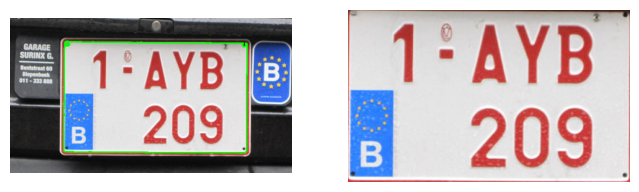

---DETECCIÓN DE NUMEROS---
Negro: 6366.0   Blanco: 87083.0
Area Promedio 901.8618421052631


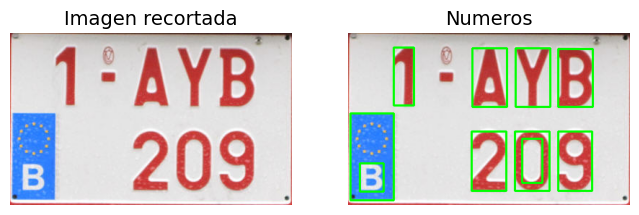

In [17]:
# find_numbers("LicencePlates/images4.jpg")

Filename: images10.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 244
Extend: 0.9702932639375438
Area: 48471.0
Area Imagen: 198000
Porcentaje de la placa: 0.2448030303030303


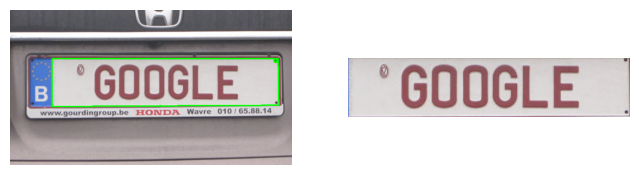

---DETECCIÓN DE NUMEROS---
Negro: 1941.0   Blanco: 48014.0
Area Promedio 2916.96


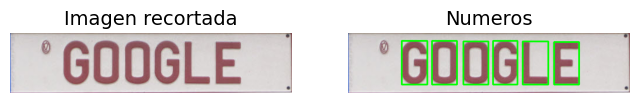

Filename: images100.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 35
Extend: 0.9834596893491124
Area: 53185.5
Area Imagen: 198000
Porcentaje de la placa: 0.2686136363636364


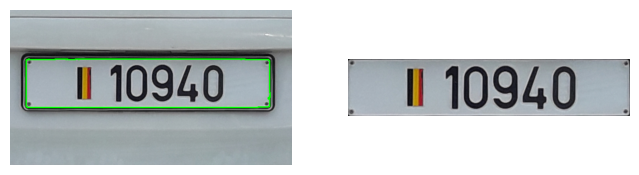

---DETECCIÓN DE NUMEROS---
Negro: 9375.0   Blanco: 44705.0
Area Promedio 2535.7


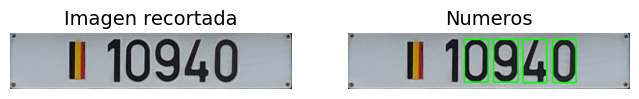

Filename: images101.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 66
Extend: 0.9703540618260245
Area: 53990.5
Area Imagen: 198000
Porcentaje de la placa: 0.27267929292929294


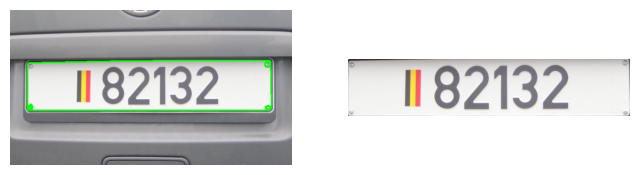

---DETECCIÓN DE NUMEROS---
Negro: 864.0   Blanco: 54776.0
Area Promedio 722.4594594594595


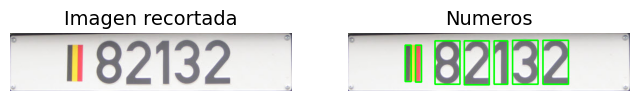

Filename: images102.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 339
Extend: 0.9695399337504601
Area: 65856.0
Area Imagen: 198000
Porcentaje de la placa: 0.3326060606060606


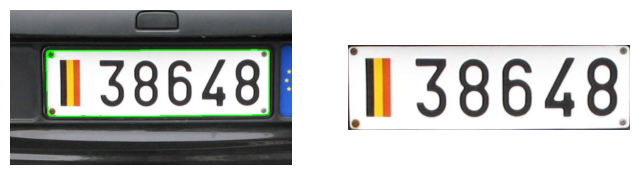

---DETECCIÓN DE NUMEROS---
Negro: 13178.0   Blanco: 54747.0
Area Promedio 4762.523809523809


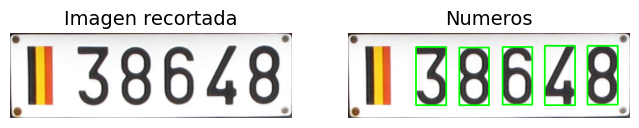

Filename: images103.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 560
Extend: 0.9644060377758913
Area: 72708.5
Area Imagen: 198000
Porcentaje de la placa: 0.36721464646464647


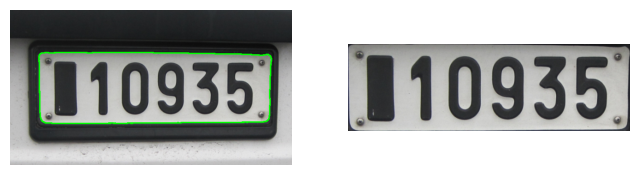

---DETECCIÓN DE NUMEROS---
Negro: 25306.0   Blanco: 50086.0
Area Promedio 2369.6341463414633


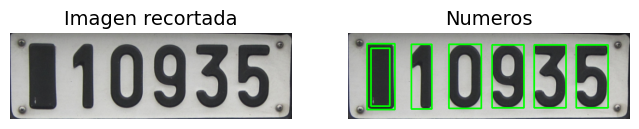

Filename: images104.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 337
Extend: 0.8788751052344872
Area: 70988.5
Area Imagen: 198000
Porcentaje de la placa: 0.3585277777777778


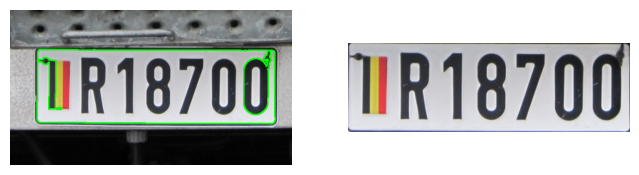

---DETECCIÓN DE NUMEROS---
Negro: 22977.0   Blanco: 57795.0
Area Promedio 3799.5


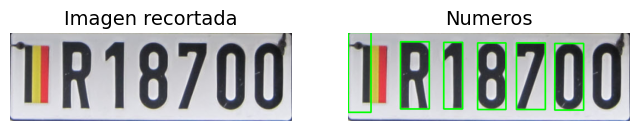

Filename: images105.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 584
Extend: 0.6074380165289256
Area: 73.5
Area Imagen: 198000
Porcentaje de la placa: 0.00037121212121212123


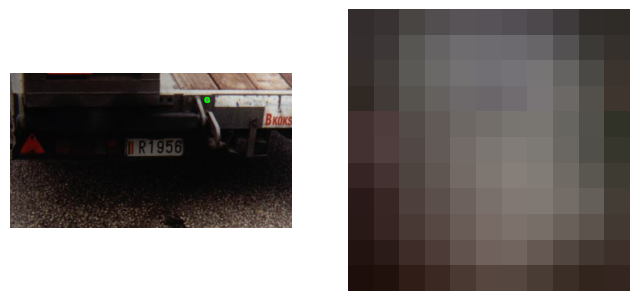

---DETECCIÓN DE NUMEROS---
Negro: 81.0   Blanco: 40.0
Area Promedio 13.75


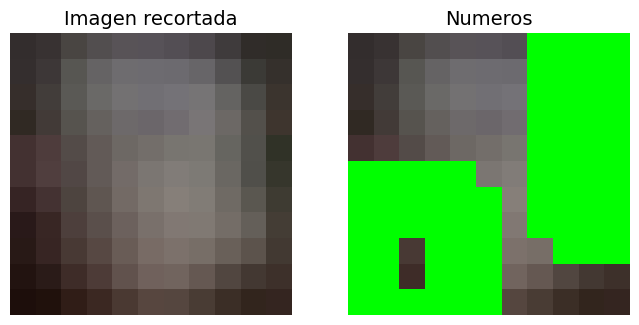

Filename: images106.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 90
Extend: 0.7266666666666667
Area: 490.5
Area Imagen: 198000
Porcentaje de la placa: 0.0024772727272727273


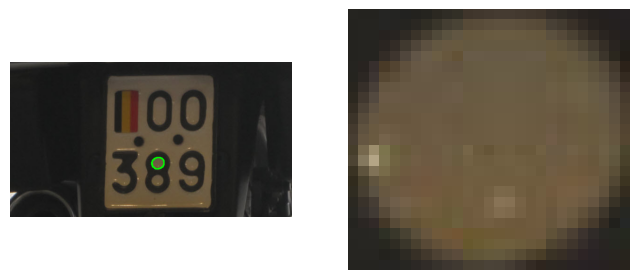

---DETECCIÓN DE NUMEROS---
Negro: 655.0   Blanco: 20.0
Area Promedio 138.75


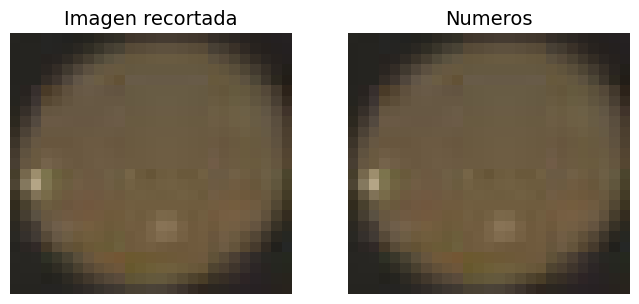

Filename: images107.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1187
Extend: 0.9452847726888626
Area: 11186.5
Area Imagen: 198000
Porcentaje de la placa: 0.05649747474747475


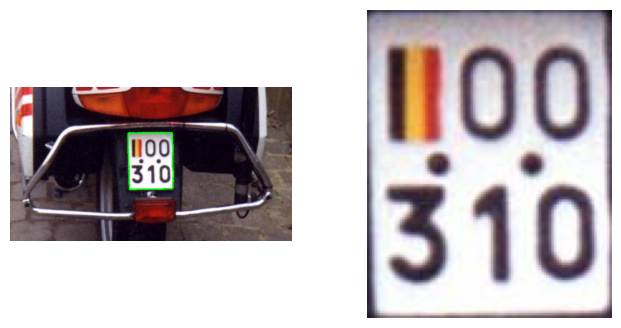

---DETECCIÓN DE NUMEROS---
Negro: 2261.0   Blanco: 9573.0
Area Promedio 1381.6153846153845


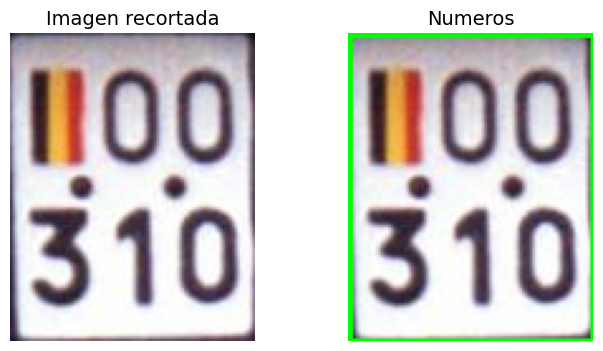

Filename: images108.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 275
Extend: 0.9696027708940191
Area: 66905.5
Area Imagen: 198000
Porcentaje de la placa: 0.3379065656565657


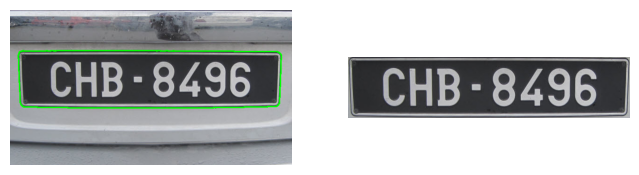

---DETECCIÓN DE NUMEROS---
Negro: 46056.0   Blanco: 22947.0
Area Promedio 3089.506329113924


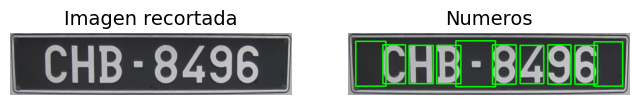

Filename: images109.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 407
Extend: 0.9549075219503365
Area: 63297.0
Area Imagen: 198000
Porcentaje de la placa: 0.3196818181818182


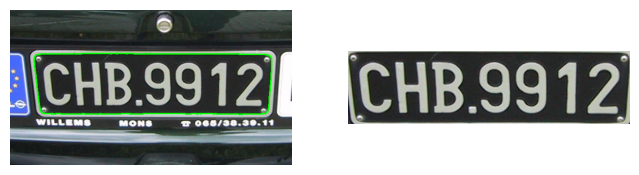

---DETECCIÓN DE NUMEROS---
Negro: 43876.0   Blanco: 22410.0
Area Promedio 700.8743169398907


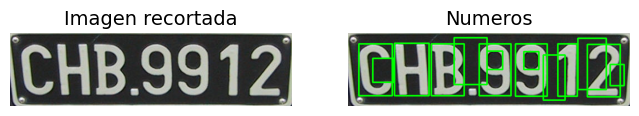

Filename: images11.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 569
Extend: 0.968392523364486
Area: 51809.0
Area Imagen: 198000
Porcentaje de la placa: 0.26166161616161615


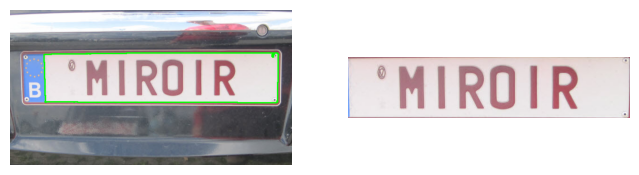

---DETECCIÓN DE NUMEROS---
Negro: 5.0   Blanco: 53495.0
Area Promedio 648.2307692307693


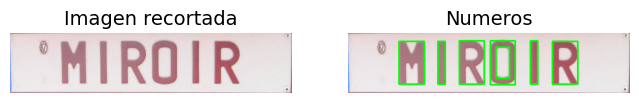

Filename: images110.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 235
Extend: 0.9617163021324491
Area: 63229.0
Area Imagen: 198000
Porcentaje de la placa: 0.31933838383838387


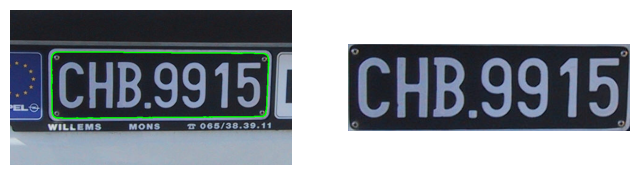

---DETECCIÓN DE NUMEROS---
Negro: 45503.0   Blanco: 20243.0
Area Promedio 631.7649769585254


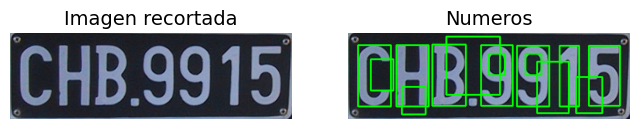

Filename: images111.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 376
Extend: 0.8347936771061512
Area: 56402.0
Area Imagen: 198000
Porcentaje de la placa: 0.28485858585858587


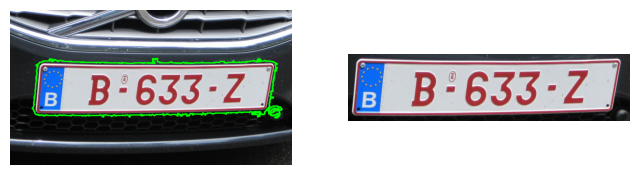

---DETECCIÓN DE NUMEROS---
Negro: 28970.0   Blanco: 38594.0
Area Promedio 1235.6352201257862


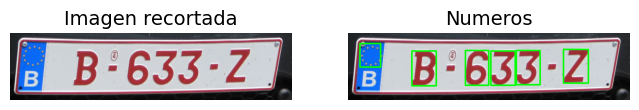

Filename: images112.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 433
Extend: 0.9659822039698837
Area: 49395.5
Area Imagen: 198000
Porcentaje de la placa: 0.24947222222222223


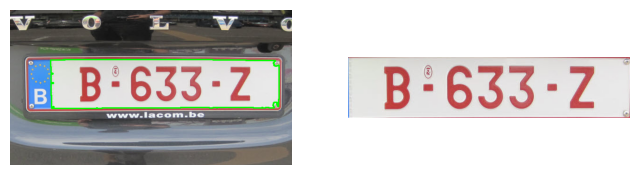

---DETECCIÓN DE NUMEROS---
Negro: 860.0   Blanco: 50275.0
Area Promedio 1131.5135135135135


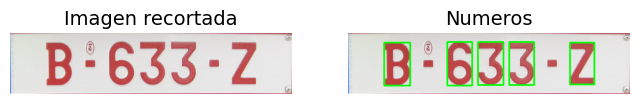

Filename: images113.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 728
Extend: 0.9276231704803133
Area: 44999.0
Area Imagen: 198000
Porcentaje de la placa: 0.22726767676767676


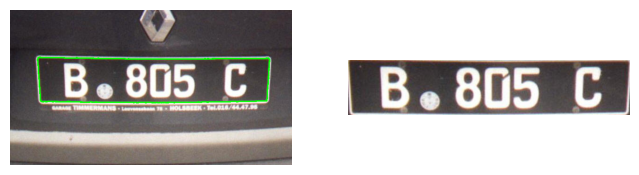

---DETECCIÓN DE NUMEROS---
Negro: 27985.0   Blanco: 20525.0
Area Promedio 422.1747572815534


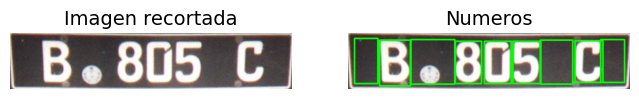

Filename: images114.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 667
Extend: 0.823093220338983
Area: 9712.5
Area Imagen: 198000
Porcentaje de la placa: 0.0490530303030303


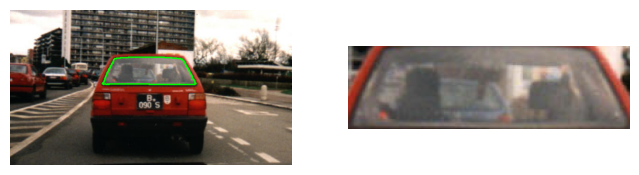

---DETECCIÓN DE NUMEROS---
Negro: 4032.0   Blanco: 7768.0
Area Promedio 385.01960784313724


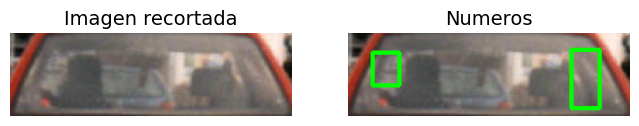

Filename: images115.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 396
Extend: 0.8239102564102564
Area: 64265.0
Area Imagen: 198000
Porcentaje de la placa: 0.32457070707070707


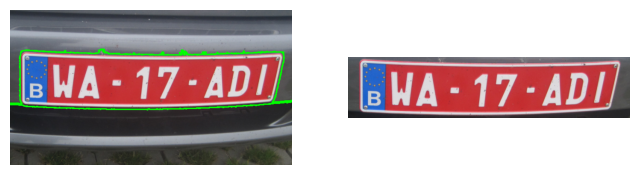

---DETECCIÓN DE NUMEROS---
Negro: 47486.0   Blanco: 30514.0
Area Promedio 1058.8636363636363


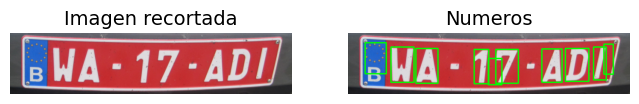

Filename: images116.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 131
Extend: 0.9682911291606944
Area: 60799.0
Area Imagen: 198000
Porcentaje de la placa: 0.30706565656565654


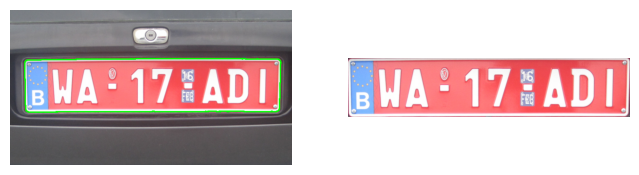

---DETECCIÓN DE NUMEROS---
Negro: 181.0   Blanco: 62609.0
Area Promedio 743.8544061302682


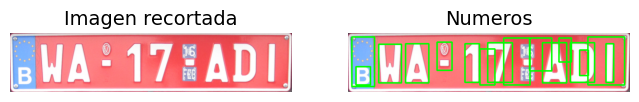

Filename: images117.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 441
Extend: 0.832579185520362
Area: 184.0
Area Imagen: 198000
Porcentaje de la placa: 0.0009292929292929292


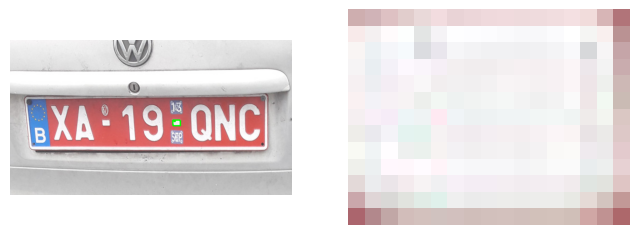

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 221.0
Area Promedio 5.285714285714286


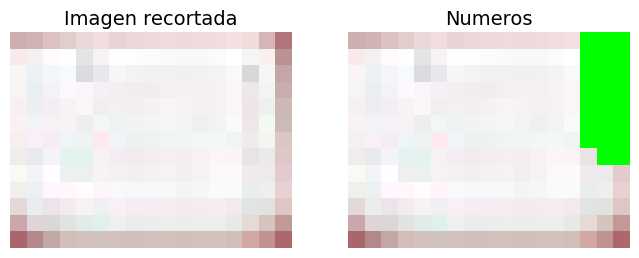

Filename: images118.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 659
Extend: 0.8960425335182617
Area: 48453.5
Area Imagen: 198000
Porcentaje de la placa: 0.24471464646464647


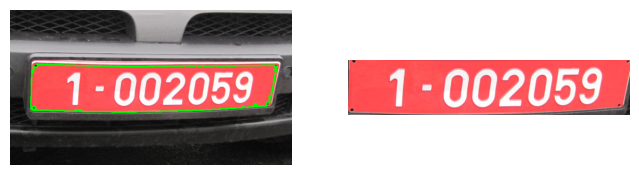

---DETECCIÓN DE NUMEROS---
Negro: 2207.0   Blanco: 51868.0
Area Promedio 718.8148148148148


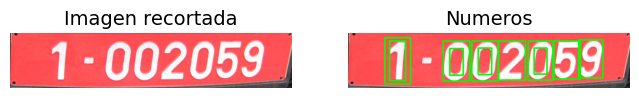

Filename: images119.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 806
Extend: 0.9169412676875364
Area: 37844.0
Area Imagen: 198000
Porcentaje de la placa: 0.19113131313131312


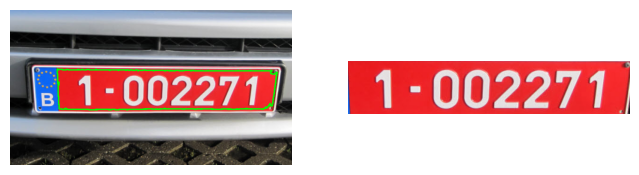

---DETECCIÓN DE NUMEROS---
Negro: 18131.0   Blanco: 23141.0
Area Promedio 828.6619718309859


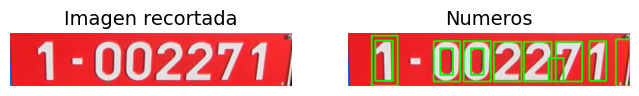

Filename: images12.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 250
Extend: 0.9628920786815524
Area: 45280.0
Area Imagen: 198000
Porcentaje de la placa: 0.2286868686868687


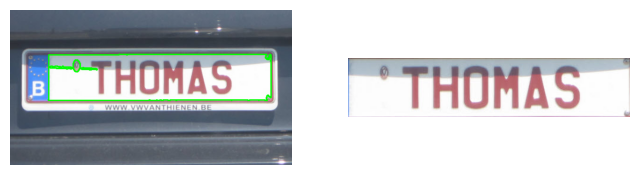

---DETECCIÓN DE NUMEROS---
Negro: 850.0   Blanco: 46175.0
Area Promedio 1896.0


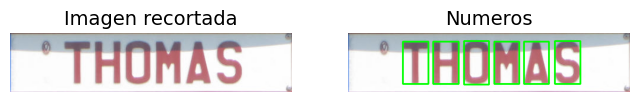

Filename: images120.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 331
Extend: 0.932954872089681
Area: 77898.0
Area Imagen: 198000
Porcentaje de la placa: 0.3934242424242424


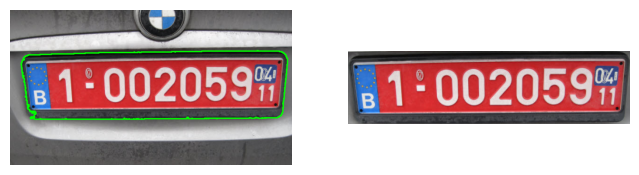

---DETECCIÓN DE NUMEROS---
Negro: 51006.0   Blanco: 32490.0
Area Promedio 808.3238095238095


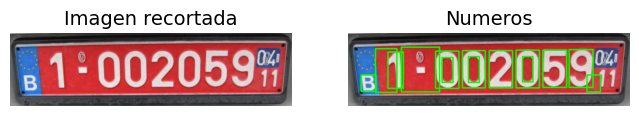

Filename: images121.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 602
Extend: 0.8643561786085151
Area: 3329.5
Area Imagen: 198000
Porcentaje de la placa: 0.016815656565656565


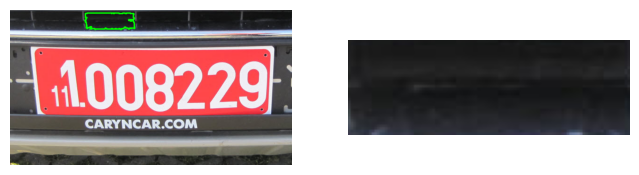

---DETECCIÓN DE NUMEROS---
Negro: 3847.0   Blanco: 5.0
Area Promedio 74.6842105263158


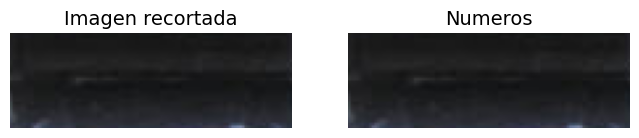

Filename: images122.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 468
Extend: 0.8993260608048994
Area: 65787.5
Area Imagen: 198000
Porcentaje de la placa: 0.332260101010101


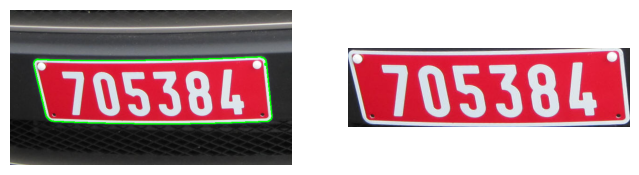

---DETECCIÓN DE NUMEROS---
Negro: 43273.0   Blanco: 29879.0
Area Promedio 1998.1976744186047


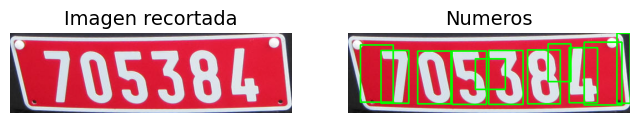

Filename: images123.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 38
Extend: 0.8509217171717172
Area: 101089.5
Area Imagen: 198000
Porcentaje de la placa: 0.5105530303030303


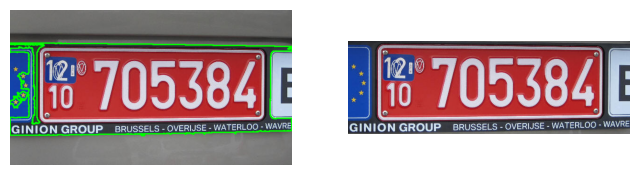

---DETECCIÓN DE NUMEROS---
Negro: 75240.0   Blanco: 43560.0
Area Promedio 632.7207062600321


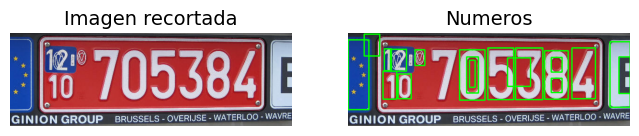

Filename: images124.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 504
Extend: 0.963077694235589
Area: 48033.5
Area Imagen: 198000
Porcentaje de la placa: 0.24259343434343433


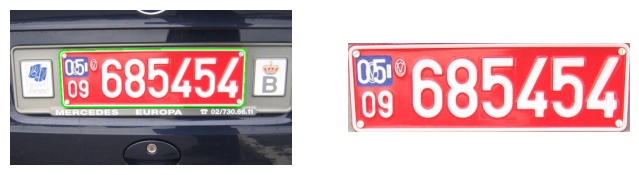

---DETECCIÓN DE NUMEROS---
Negro: 526.0   Blanco: 49349.0
Area Promedio 565.0


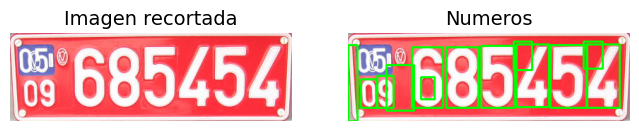

Filename: images125.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1520
Extend: 0.9456436915467086
Area: 78765.5
Area Imagen: 198000
Porcentaje de la placa: 0.3978055555555556


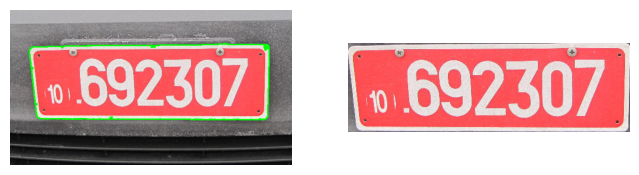

---DETECCIÓN DE NUMEROS---
Negro: 898.0   Blanco: 82395.0
Area Promedio 261.03297872340426


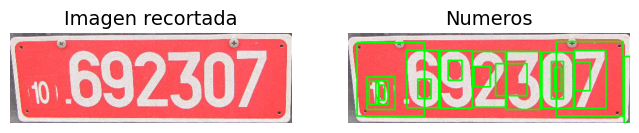

Filename: images126.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 135
Extend: 0.9521194816604437
Area: 73695.0
Area Imagen: 198000
Porcentaje de la placa: 0.3721969696969697


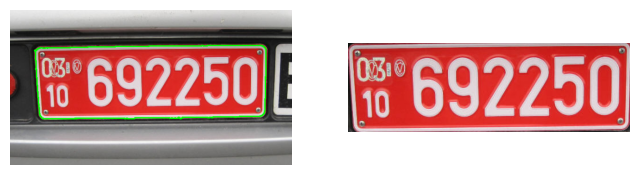

---DETECCIÓN DE NUMEROS---
Negro: 37761.0   Blanco: 39640.0
Area Promedio 1125.8362068965516


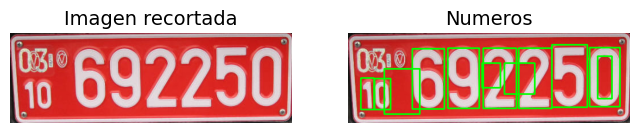

Filename: images127.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 574
Extend: 0.8469433076361791
Area: 53393.0
Area Imagen: 198000
Porcentaje de la placa: 0.26966161616161616


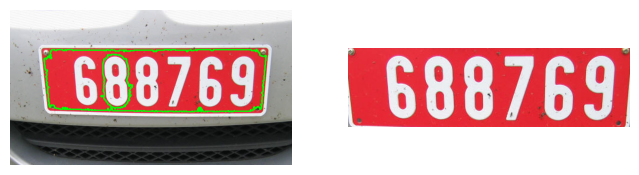

---DETECCIÓN DE NUMEROS---
Negro: 23370.0   Blanco: 39672.0
Area Promedio 448.73617021276596


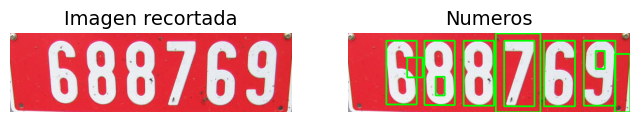

Filename: images128.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 699
Extend: 0.886677200554956
Area: 46015.0
Area Imagen: 198000
Porcentaje de la placa: 0.2323989898989899


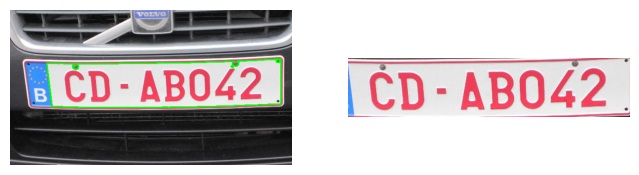

---DETECCIÓN DE NUMEROS---
Negro: 421.0   Blanco: 51475.0
Area Promedio 713.4230769230769


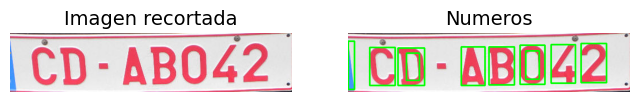

Filename: images129.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 645
Extend: 0.8602114121510673
Area: 83819.0
Area Imagen: 198000
Porcentaje de la placa: 0.42332828282828283


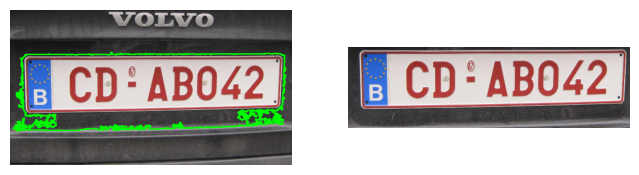

---DETECCIÓN DE NUMEROS---
Negro: 43897.0   Blanco: 53543.0
Area Promedio 560.2803418803419


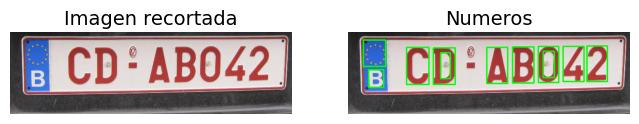

Filename: images13.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 683
Extend: 0.9019371282922685
Area: 53079.0
Area Imagen: 198000
Porcentaje de la placa: 0.2680757575757576


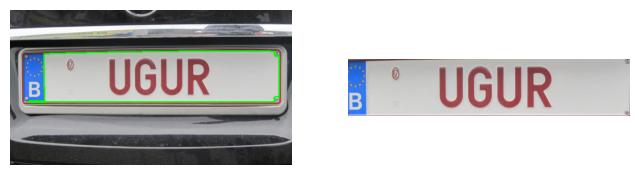

---DETECCIÓN DE NUMEROS---
Negro: 7059.0   Blanco: 51791.0
Area Promedio 1082.1285714285714


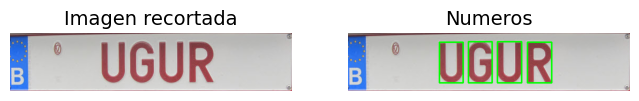

Filename: images130.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 732
Extend: 0.882291330970029
Area: 32853.0
Area Imagen: 198000
Porcentaje de la placa: 0.16592424242424242


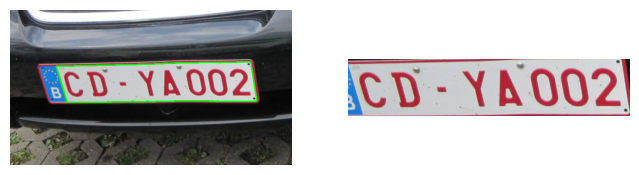

---DETECCIÓN DE NUMEROS---
Negro: 7793.0   Blanco: 29443.0
Area Promedio 561.5882352941177


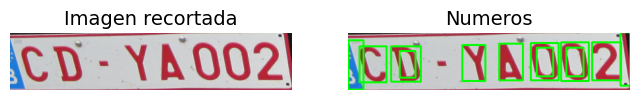

Filename: images131.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 188
Extend: 0.9825038700584552
Area: 85047.5
Area Imagen: 198000
Porcentaje de la placa: 0.4295328282828283


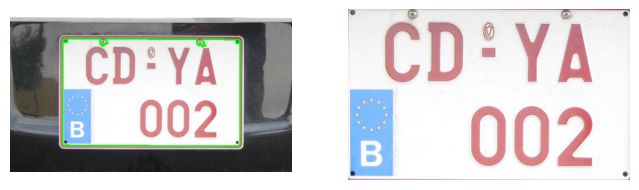

---DETECCIÓN DE NUMEROS---
Negro: 100.0   Blanco: 86462.0
Area Promedio 307.94444444444446


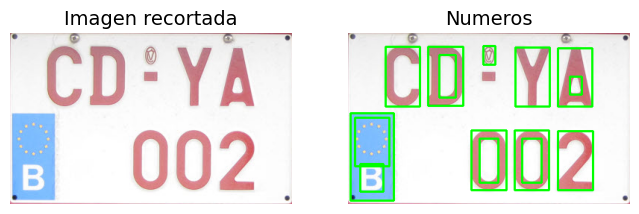

Filename: images132.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1377
Extend: 0.9155554512160766
Area: 38999.0
Area Imagen: 198000
Porcentaje de la placa: 0.19696464646464645


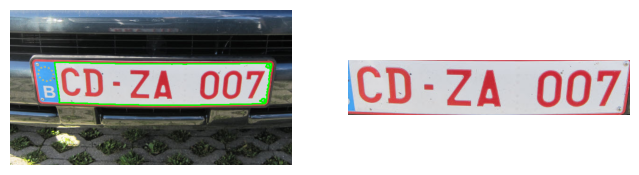

---DETECCIÓN DE NUMEROS---
Negro: 3796.0   Blanco: 38800.0
Area Promedio 367.73333333333335


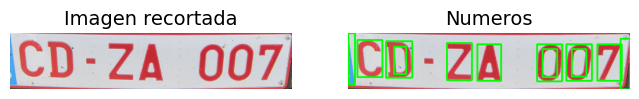

Filename: images133.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 221
Extend: 0.8959853603603604
Area: 79563.5
Area Imagen: 198000
Porcentaje de la placa: 0.4018358585858586


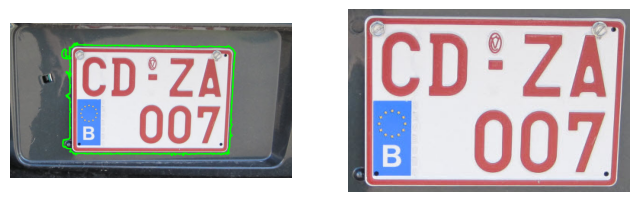

---DETECCIÓN DE NUMEROS---
Negro: 4533.0   Blanco: 84267.0
Area Promedio 1791.1256281407036


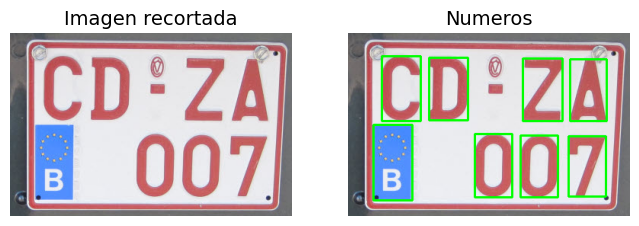

Filename: images134.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 226
Extend: 0.9063480911015402
Area: 99328.5
Area Imagen: 198000
Porcentaje de la placa: 0.5016590909090909


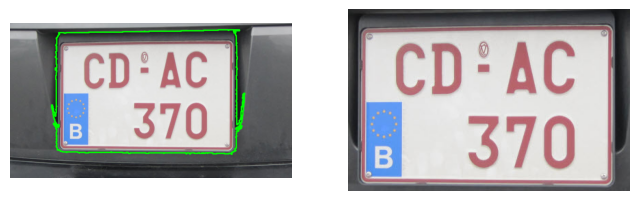

---DETECCIÓN DE NUMEROS---
Negro: 22575.0   Blanco: 87017.0
Area Promedio 2757.7413793103447


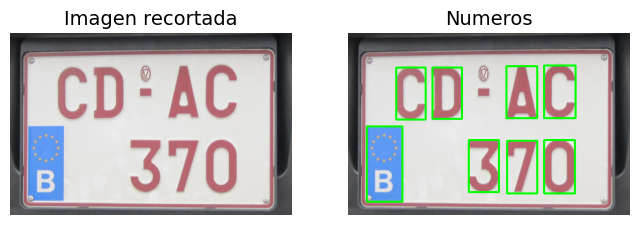

Filename: images135.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1270
Extend: 0.9525618845898883
Area: 58915.0
Area Imagen: 198000
Porcentaje de la placa: 0.29755050505050507


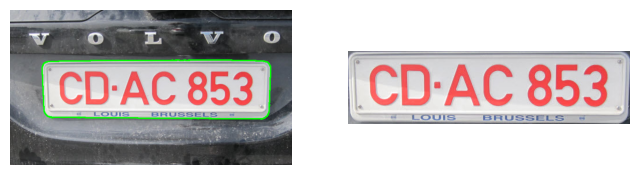

---DETECCIÓN DE NUMEROS---
Negro: 803.0   Blanco: 61046.0
Area Promedio 2354.3


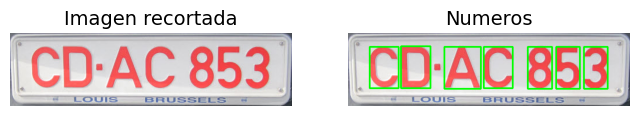

Filename: images136.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 370
Extend: 0.9645750661375662
Area: 58337.5
Area Imagen: 198000
Porcentaje de la placa: 0.2946338383838384


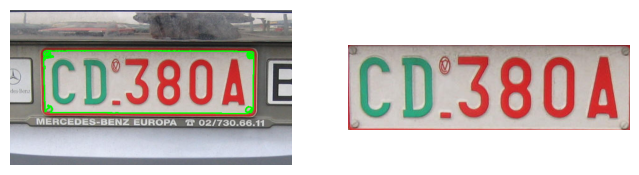

---DETECCIÓN DE NUMEROS---
Negro: 9182.0   Blanco: 51298.0
Area Promedio 1111.3522727272727


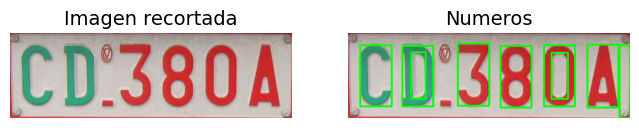

Filename: images137.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 205
Extend: 0.9621134020618557
Area: 69060.5
Area Imagen: 198000
Porcentaje de la placa: 0.34879040404040407


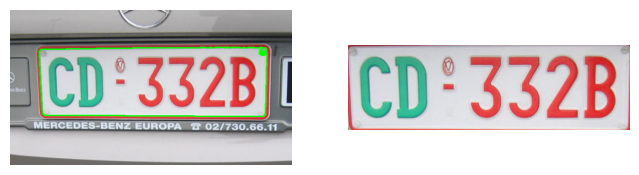

---DETECCIÓN DE NUMEROS---
Negro: 2888.0   Blanco: 68892.0
Area Promedio 1142.741935483871


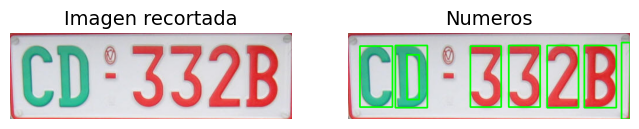

Filename: images138.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 646
Extend: 0.9587392716307122
Area: 66130.0
Area Imagen: 198000
Porcentaje de la placa: 0.333989898989899


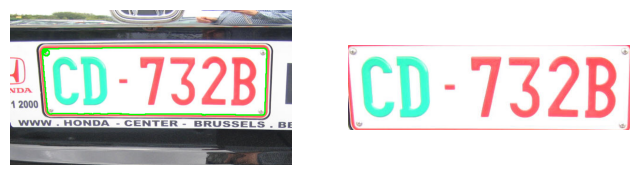

---DETECCIÓN DE NUMEROS---
Negro: 130.0   Blanco: 68846.0
Area Promedio 1896.2592592592594


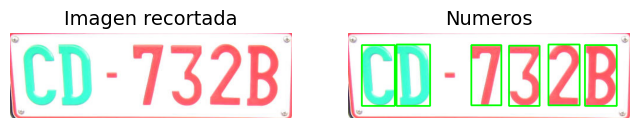

Filename: images139.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 367
Extend: 0.9350827730788693
Area: 64675.0
Area Imagen: 198000
Porcentaje de la placa: 0.3266414141414141


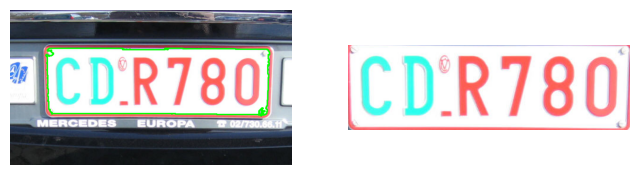

---DETECCIÓN DE NUMEROS---
Negro: 32.0   Blanco: 69133.0
Area Promedio 2847.35


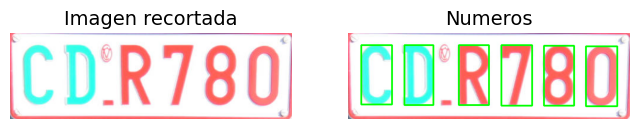

Filename: images14.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 660
Extend: 0.9640468667719853
Area: 36614.5
Area Imagen: 198000
Porcentaje de la placa: 0.18492171717171718


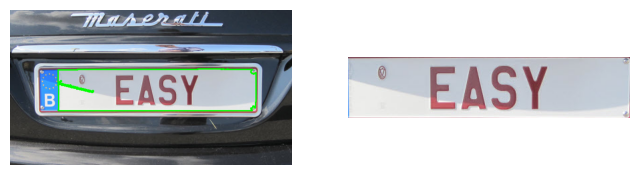

---DETECCIÓN DE NUMEROS---
Negro: 1433.0   Blanco: 36547.0
Area Promedio 359.25531914893617


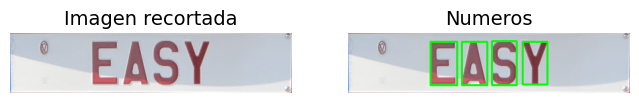

Filename: images140.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 397
Extend: 0.8802073178657308
Area: 27087.5
Area Imagen: 198000
Porcentaje de la placa: 0.13680555555555557


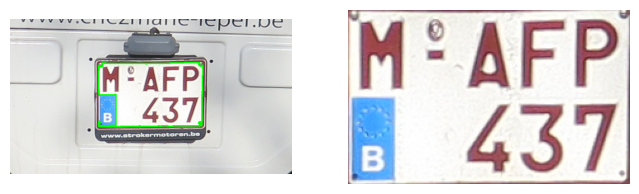

---DETECCIÓN DE NUMEROS---
Negro: 3187.0   Blanco: 27587.0
Area Promedio 463.64948453608247


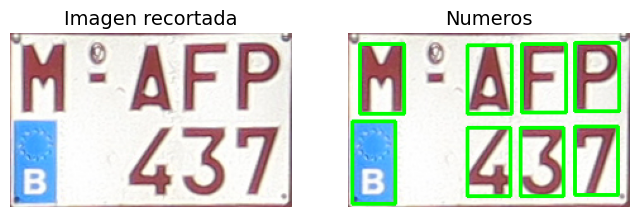

Filename: images141.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1113
Extend: 0.8679997957542412
Area: 67996.5
Area Imagen: 198000
Porcentaje de la placa: 0.34341666666666665


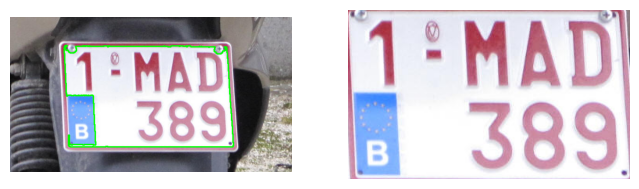

---DETECCIÓN DE NUMEROS---
Negro: 1294.0   Blanco: 77043.0
Area Promedio 646.8659793814433


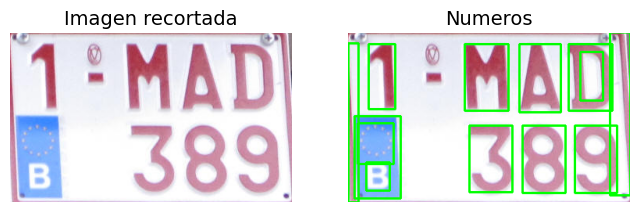

Filename: images142.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1217
Extend: 0.6486486486486487
Area: 144.0
Area Imagen: 198000
Porcentaje de la placa: 0.0007272727272727272


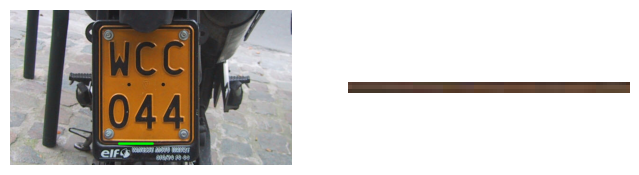

---DETECCIÓN DE NUMEROS---
Negro: 222.0   Blanco: 0.0
Area Promedio 8.5


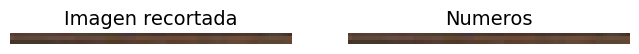

Filename: images143.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 977
Extend: 0.9518391787852866
Area: 33381.0
Area Imagen: 198000
Porcentaje de la placa: 0.1685909090909091


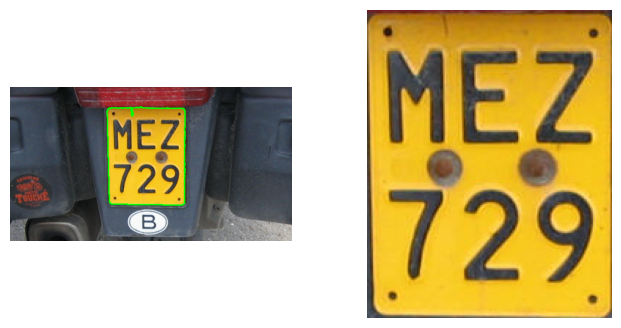

---DETECCIÓN DE NUMEROS---
Negro: 7803.0   Blanco: 27267.0
Area Promedio 1181.1860465116279


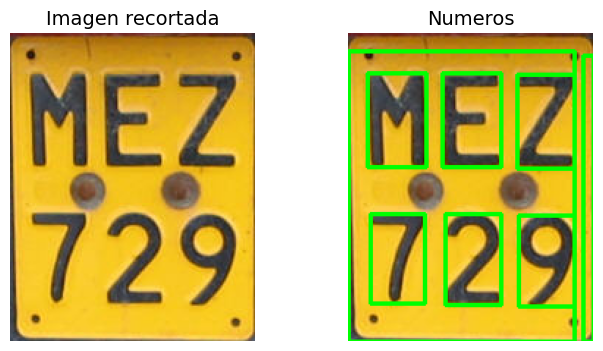

Filename: images144.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1070
Extend: 0.8629001740709907
Area: 34204.5
Area Imagen: 198000
Porcentaje de la placa: 0.17275


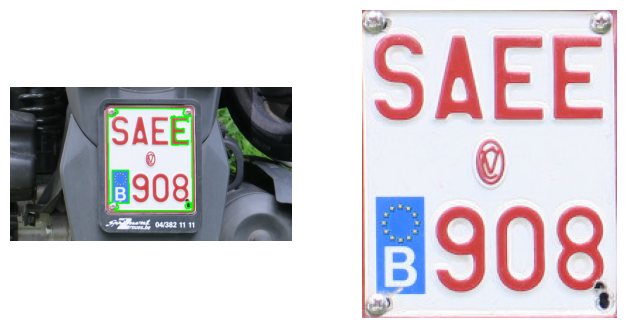

---DETECCIÓN DE NUMEROS---
Negro: 185.0   Blanco: 39454.0
Area Promedio 266.06796116504853


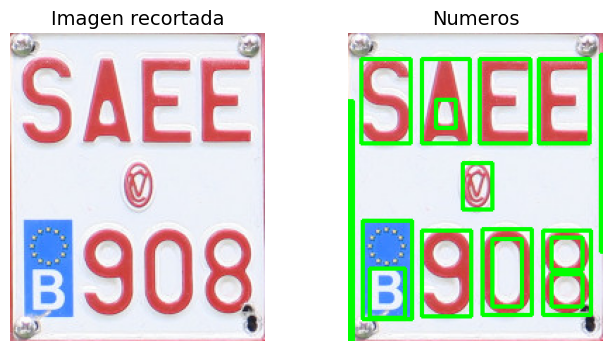

Filename: images145.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 898
Extend: 0.8102847913703177
Area: 54684.5
Area Imagen: 198000
Porcentaje de la placa: 0.27618434343434345


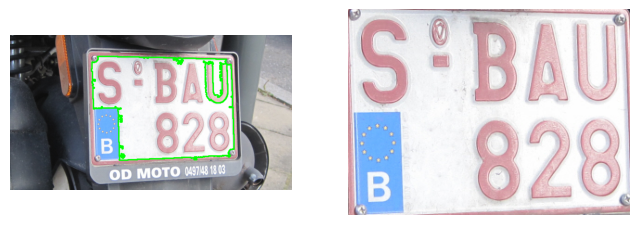

---DETECCIÓN DE NUMEROS---
Negro: 14.0   Blanco: 67474.0
Area Promedio 182.58662613981764


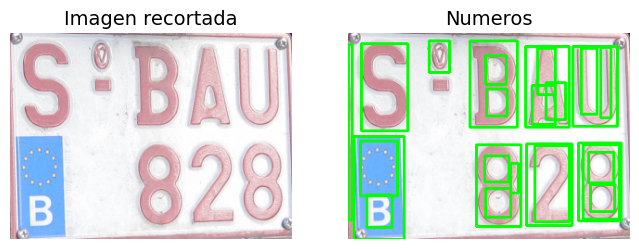

Filename: images146.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 740
Extend: 0.8978472222222222
Area: 51716.0
Area Imagen: 198000
Porcentaje de la placa: 0.2611919191919192


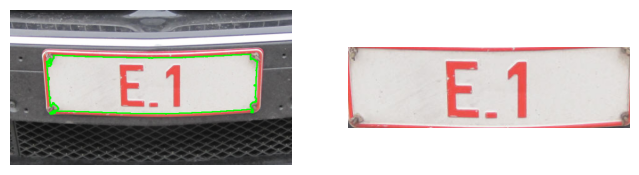

---DETECCIÓN DE NUMEROS---
Negro: 176.0   Blanco: 57424.0
Area Promedio 698.6831683168317


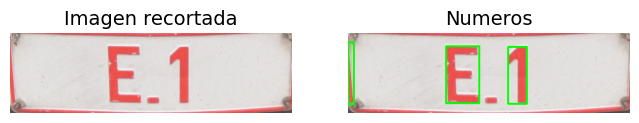

Filename: images147.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 370
Extend: 0.8943359952676723
Area: 60475.0
Area Imagen: 198000
Porcentaje de la placa: 0.30542929292929294


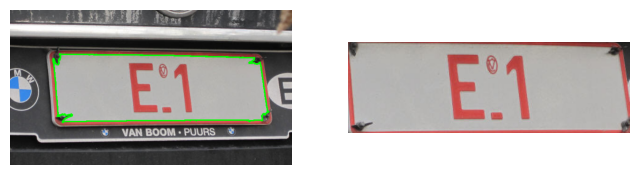

---DETECCIÓN DE NUMEROS---
Negro: 3548.0   Blanco: 64072.0
Area Promedio 1620.3035714285713


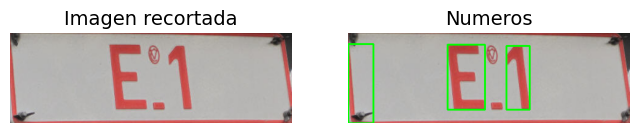

Filename: images148.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 562
Extend: 0.8386295180722891
Area: 16705.5
Area Imagen: 198000
Porcentaje de la placa: 0.08437121212121212


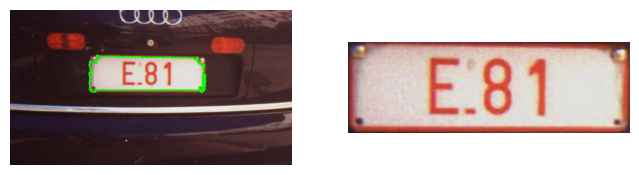

---DETECCIÓN DE NUMEROS---
Negro: 2097.0   Blanco: 17823.0
Area Promedio 1072.1707317073171


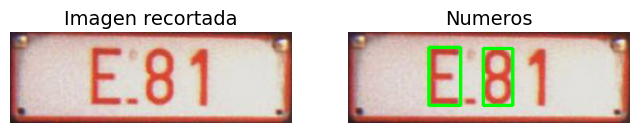

Filename: images149.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 449
Extend: 0.9402408205738071
Area: 50600.0
Area Imagen: 198000
Porcentaje de la placa: 0.25555555555555554


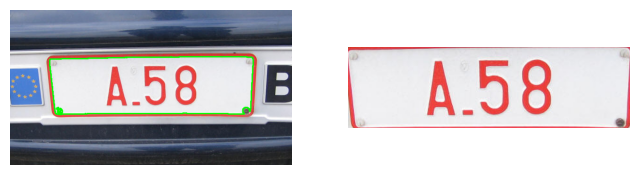

---DETECCIÓN DE NUMEROS---
Negro: 126.0   Blanco: 53690.0
Area Promedio 1815.6


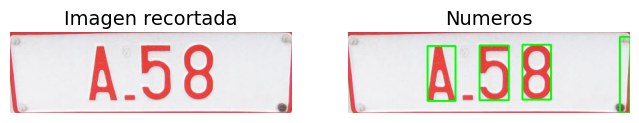

Filename: images15.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 822
Extend: 0.9167837284167398
Area: 31326.5
Area Imagen: 198000
Porcentaje de la placa: 0.15821464646464647


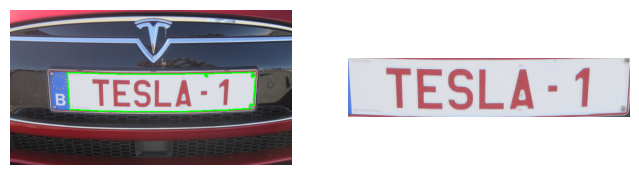

---DETECCIÓN DE NUMEROS---
Negro: 92.0   Blanco: 34078.0
Area Promedio 1240.0714285714287


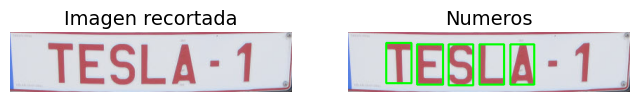

Filename: images150.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 807
Extend: 0.9379693900773782
Area: 32971.5
Area Imagen: 198000
Porcentaje de la placa: 0.16652272727272727


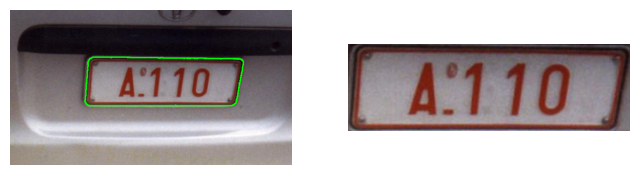

---DETECCIÓN DE NUMEROS---
Negro: 13424.0   Blanco: 21728.0
Area Promedio 894.7471264367816


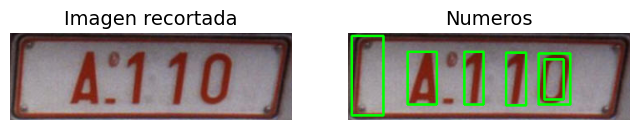

Filename: images151.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 420
Extend: 0.9387241970586295
Area: 56935.5
Area Imagen: 198000
Porcentaje de la placa: 0.2875530303030303


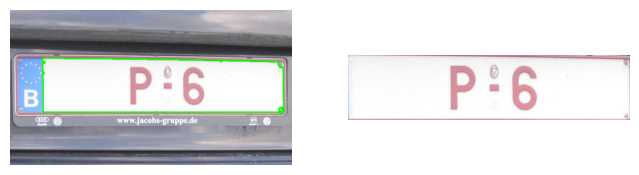

---DETECCIÓN DE NUMEROS---
Negro: 5.0   Blanco: 60647.0
Area Promedio 3043.025


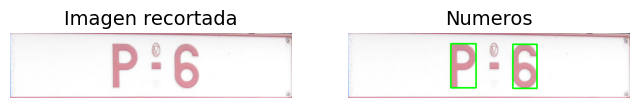

Filename: images152.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 306
Extend: 0.925335429769392
Area: 44138.5
Area Imagen: 198000
Porcentaje de la placa: 0.22292171717171716


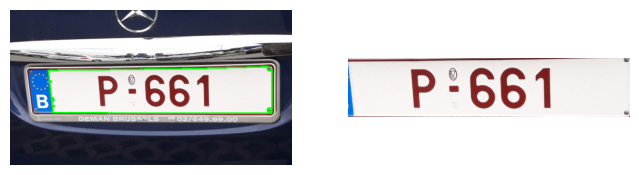

---DETECCIÓN DE NUMEROS---
Negro: 6775.0   Blanco: 40925.0
Area Promedio 323.43859649122805


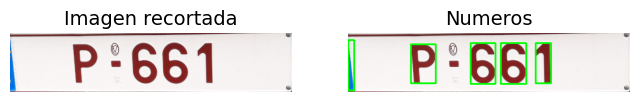

Filename: images153.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 494
Extend: 0.9193258903335217
Area: 65051.5
Area Imagen: 198000
Porcentaje de la placa: 0.3285429292929293


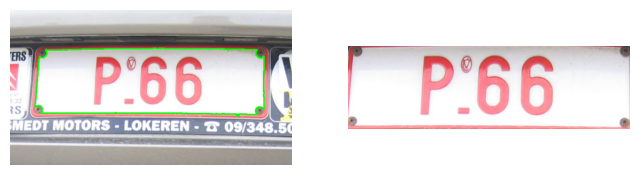

---DETECCIÓN DE NUMEROS---
Negro: 927.0   Blanco: 69833.0
Area Promedio 322.3622047244094


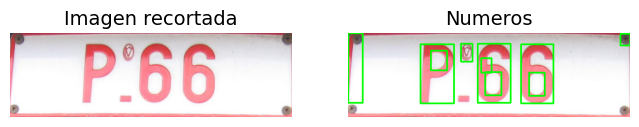

Filename: images154.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 517
Extend: 0.9586113114557038
Area: 63797.5
Area Imagen: 198000
Porcentaje de la placa: 0.322209595959596


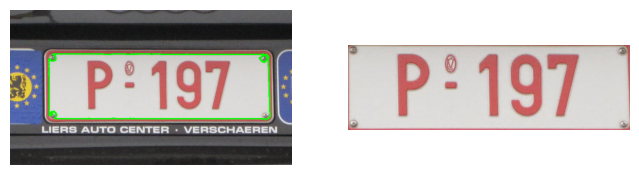

---DETECCIÓN DE NUMEROS---
Negro: 34.0   Blanco: 66518.0
Area Promedio 1284.8235294117646


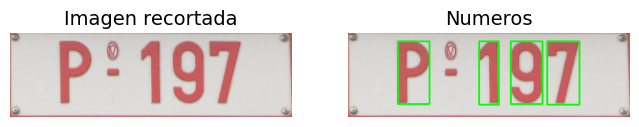

Filename: images155.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1097
Extend: 0.9114900914634146
Area: 43051.5
Area Imagen: 198000
Porcentaje de la placa: 0.21743181818181817


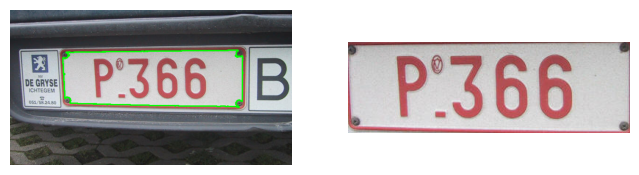

---DETECCIÓN DE NUMEROS---
Negro: 2294.0   Blanco: 44938.0
Area Promedio 243.72348484848484


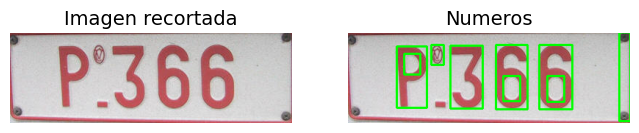

Filename: images156.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1470
Extend: 0.9227090492554411
Area: 32221.0
Area Imagen: 198000
Porcentaje de la placa: 0.16273232323232323


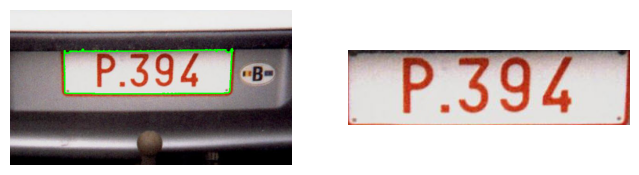

---DETECCIÓN DE NUMEROS---
Negro: 5300.0   Blanco: 29620.0
Area Promedio 1086.5555555555557


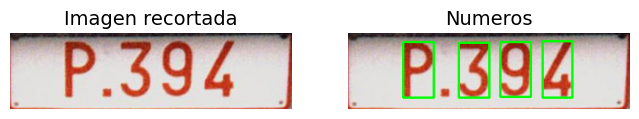

Filename: images157.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 312
Extend: 0.9274634478662638
Area: 53094.5
Area Imagen: 198000
Porcentaje de la placa: 0.2681540404040404


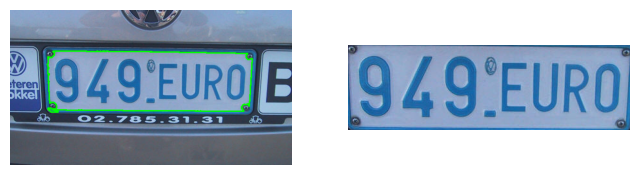

---DETECCIÓN DE NUMEROS---
Negro: 13285.0   Blanco: 43962.0
Area Promedio 397.1551724137931


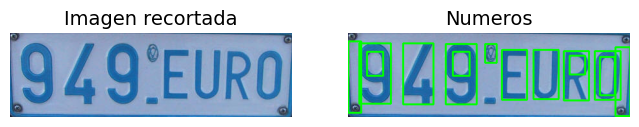

Filename: images158.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 805
Extend: 0.9396749766017187
Area: 66264.0
Area Imagen: 198000
Porcentaje de la placa: 0.33466666666666667


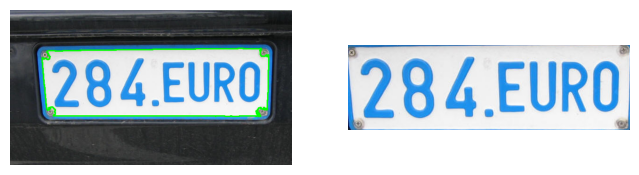

---DETECCIÓN DE NUMEROS---
Negro: 947.0   Blanco: 69571.0
Area Promedio 2352.2391304347825


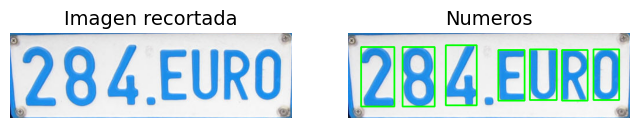

Filename: images159.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 318
Extend: 0.8888090646702209
Area: 70519.0
Area Imagen: 198000
Porcentaje de la placa: 0.35615656565656567


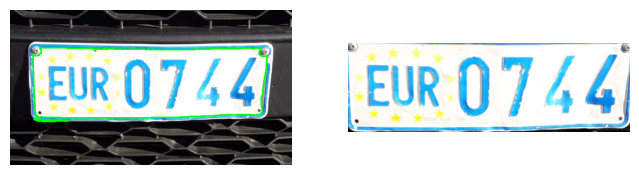

---DETECCIÓN DE NUMEROS---
Negro: 1638.0   Blanco: 77703.0
Area Promedio 375.5052083333333


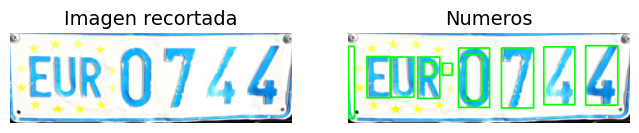

Filename: images16.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 63
Extend: 0.8041613041613042
Area: 67482.0
Area Imagen: 198000
Porcentaje de la placa: 0.3408181818181818


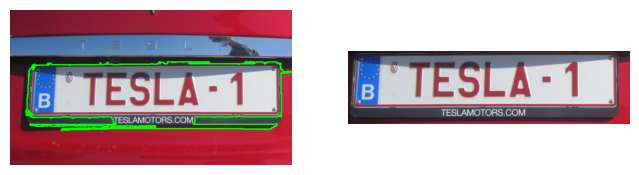

---DETECCIÓN DE NUMEROS---
Negro: 38751.0   Blanco: 45165.0
Area Promedio 1478.1531531531532


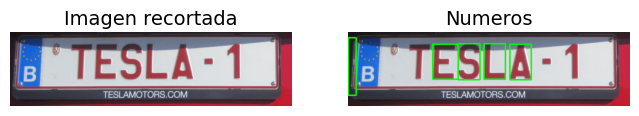

Filename: images160.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 517
Extend: 0.9574310375881514
Area: 69104.5
Area Imagen: 198000
Porcentaje de la placa: 0.34901262626262625


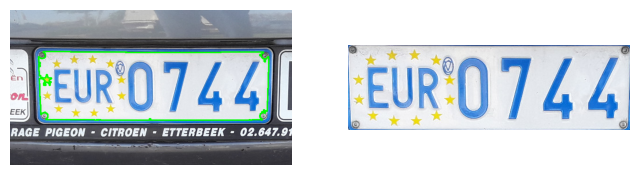

---DETECCIÓN DE NUMEROS---
Negro: 4225.0   Blanco: 67952.0
Area Promedio 373.68524590163935


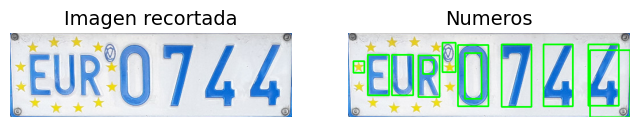

Filename: images161.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 230
Extend: 0.9293785310734464
Area: 41454.0
Area Imagen: 198000
Porcentaje de la placa: 0.20936363636363636


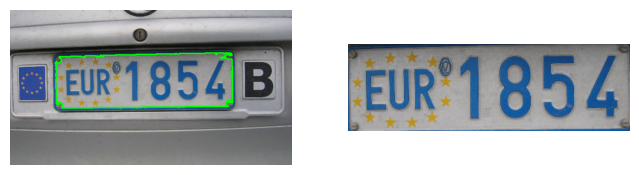

---DETECCIÓN DE NUMEROS---
Negro: 11859.0   Blanco: 32745.0
Area Promedio 276.6666666666667


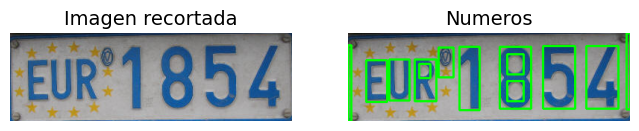

Filename: images162.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 802
Extend: 0.6944444444444444
Area: 137.5
Area Imagen: 198000
Porcentaje de la placa: 0.0006944444444444445


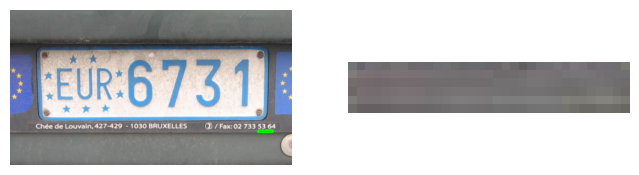

---DETECCIÓN DE NUMEROS---
Negro: 5.0   Blanco: 193.0
Area Promedio 1.9


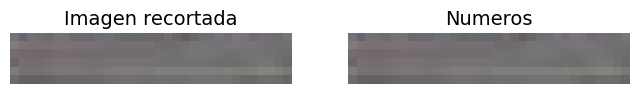

Filename: images163.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 929
Extend: 0.9052815533980583
Area: 46622.0
Area Imagen: 198000
Porcentaje de la placa: 0.23546464646464646


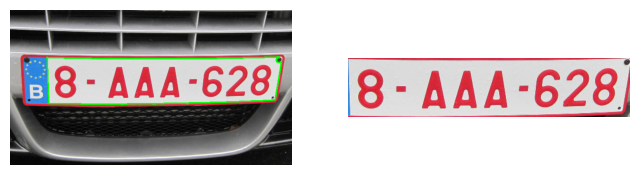

---DETECCIÓN DE NUMEROS---
Negro: 7429.0   Blanco: 44071.0
Area Promedio 1948.6923076923076


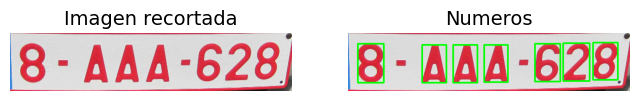

Filename: images164.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 269
Extend: 0.9076413255360624
Area: 93124.0
Area Imagen: 198000
Porcentaje de la placa: 0.4703232323232323


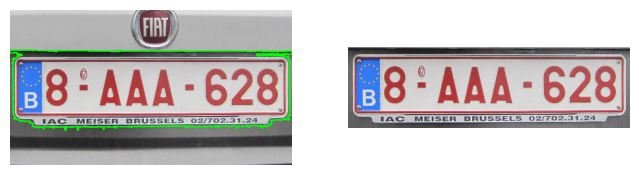

---DETECCIÓN DE NUMEROS---
Negro: 23929.0   Blanco: 78671.0
Area Promedio 1024.881690140845


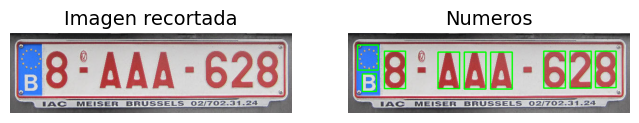

Filename: images165.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 368
Extend: 0.8699739698715109
Area: 94249.5
Area Imagen: 198000
Porcentaje de la placa: 0.47600757575757574


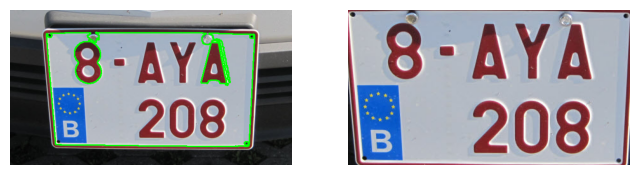

---DETECCIÓN DE NUMEROS---
Negro: 26187.0   Blanco: 82149.0
Area Promedio 627.0439560439561


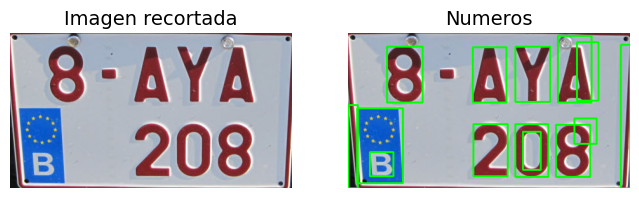

Filename: images166.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 364
Extend: 0.9504040051426577
Area: 111624.0
Area Imagen: 198000
Porcentaje de la placa: 0.5637575757575758


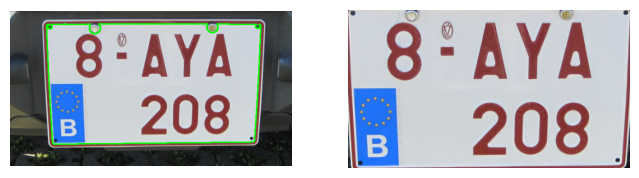

---DETECCIÓN DE NUMEROS---
Negro: 19321.0   Blanco: 98128.0
Area Promedio 1182.4233576642337


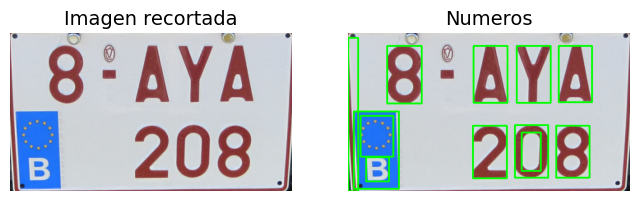

Filename: images167.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 849
Extend: 0.8072726807618025
Area: 63115.0
Area Imagen: 198000
Porcentaje de la placa: 0.31876262626262625


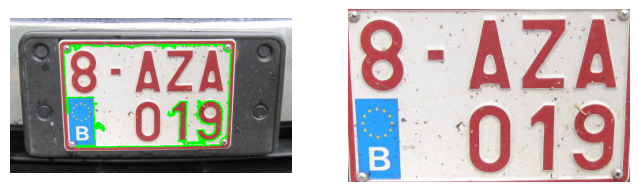

---DETECCIÓN DE NUMEROS---
Negro: 5575.0   Blanco: 72608.0
Area Promedio 209.45898778359512


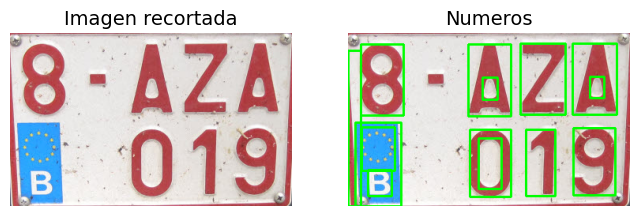

Filename: images168.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1020
Extend: 0.8355440729483282
Area: 68723.5
Area Imagen: 198000
Porcentaje de la placa: 0.34708838383838386


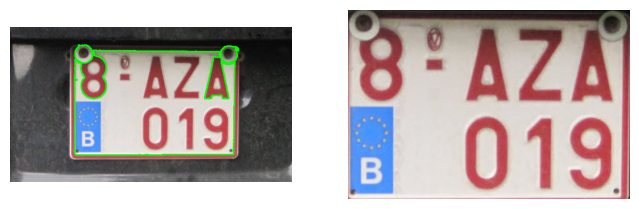

---DETECCIÓN DE NUMEROS---
Negro: 13549.0   Blanco: 68701.0
Area Promedio 1803.5714285714287


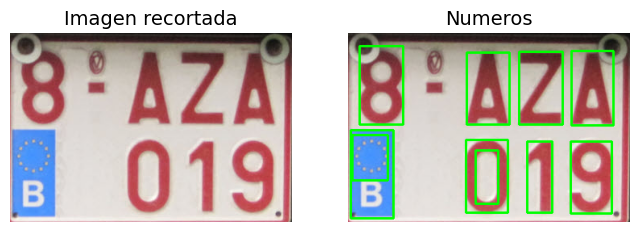

Filename: images169.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 806
Extend: 0.8218793828892006
Area: 586.0
Area Imagen: 198000
Porcentaje de la placa: 0.0029595959595959597


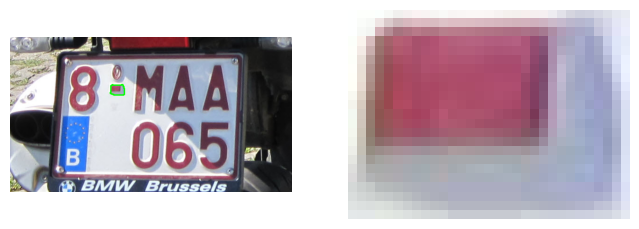

---DETECCIÓN DE NUMEROS---
Negro: 26.0   Blanco: 687.0
Area Promedio 609.0


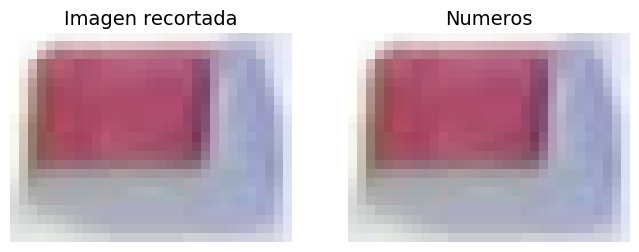

Filename: images17.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 949
Extend: 0.9319388100067614
Area: 55133.5
Area Imagen: 198000
Porcentaje de la placa: 0.2784520202020202


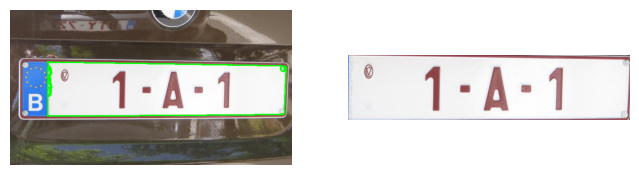

---DETECCIÓN DE NUMEROS---
Negro: 1791.0   Blanco: 57369.0
Area Promedio 1370.530612244898


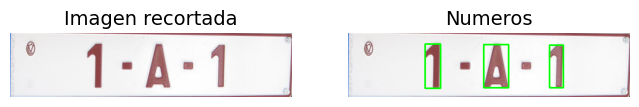

Filename: images170.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 196
Extend: 0.9346246350529254
Area: 72668.0
Area Imagen: 198000
Porcentaje de la placa: 0.367010101010101


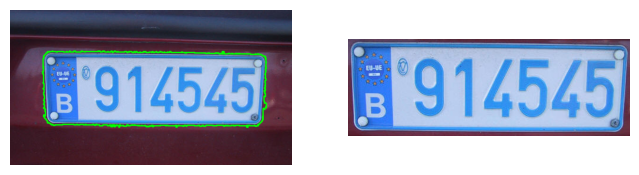

---DETECCIÓN DE NUMEROS---
Negro: 12052.0   Blanco: 65699.0
Area Promedio 782.4398826979473


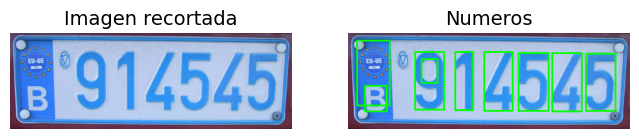

Filename: images171.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 664
Extend: 0.8390965732087228
Area: 8080.5
Area Imagen: 143667
Porcentaje de la placa: 0.05624464908434087


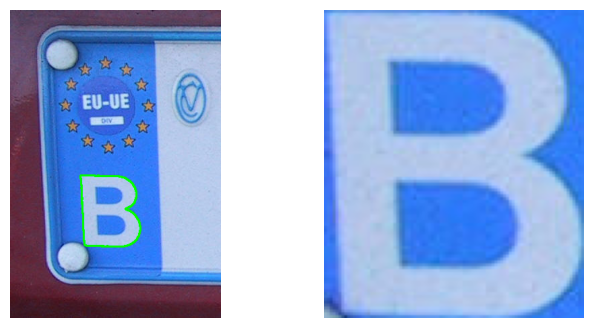

---DETECCIÓN DE NUMEROS---
Negro: 36.0   Blanco: 9594.0
Area Promedio 523.3513513513514


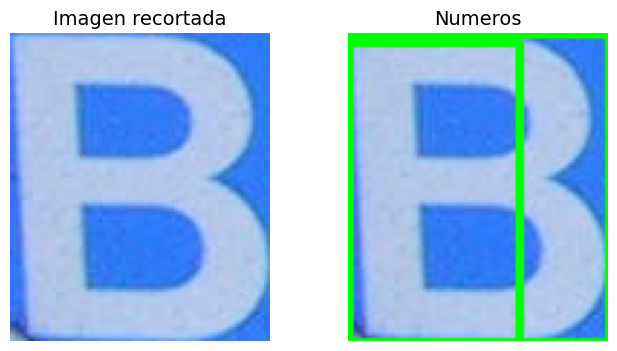

Filename: images172.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 334
Extend: 0.9481764405481318
Area: 44560.5
Area Imagen: 198000
Porcentaje de la placa: 0.2250530303030303


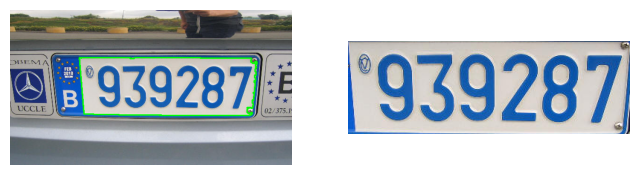

---DETECCIÓN DE NUMEROS---
Negro: 13276.0   Blanco: 33720.0
Area Promedio 748.843137254902


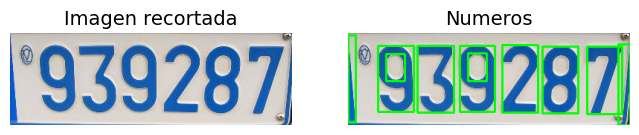

Filename: images173.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 338
Extend: 0.8294547872340425
Area: 1247.5
Area Imagen: 182325
Porcentaje de la placa: 0.006842177430412724


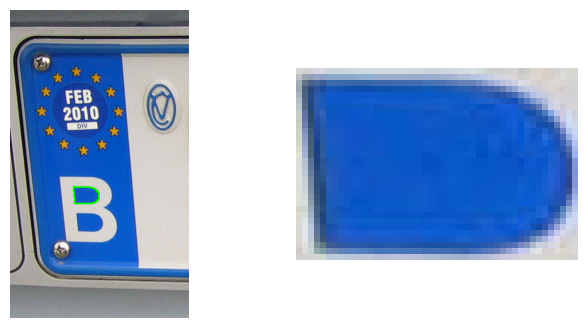

---DETECCIÓN DE NUMEROS---
Negro: 1088.0   Blanco: 416.0
Area Promedio 348.4


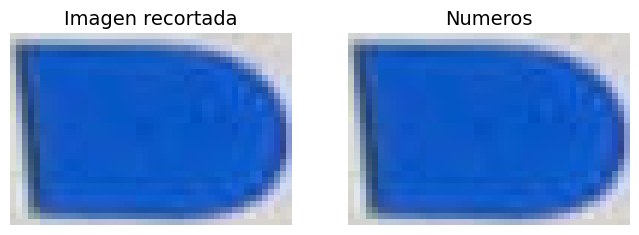

Filename: images174.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 378
Extend: 0.9411749797242498
Area: 55702.5
Area Imagen: 198000
Porcentaje de la placa: 0.28132575757575756


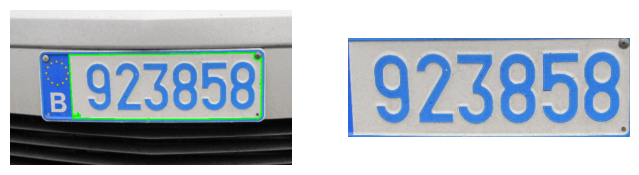

---DETECCIÓN DE NUMEROS---
Negro: 561.0   Blanco: 58623.0
Area Promedio 569.5483870967741


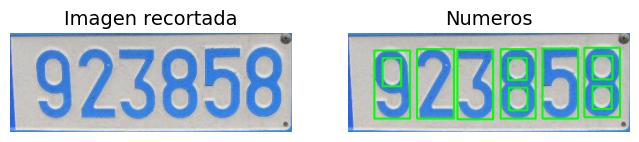

Filename: images175.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 222
Extend: 0.9474050483604624
Area: 80321.0
Area Imagen: 198000
Porcentaje de la placa: 0.40566161616161617


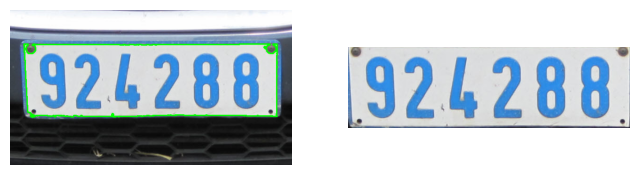

---DETECCIÓN DE NUMEROS---
Negro: 1488.0   Blanco: 83292.0
Area Promedio 567.8410041841004


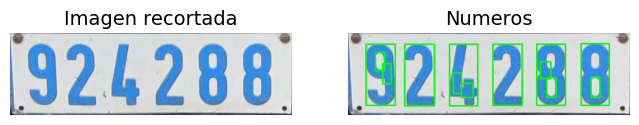

Filename: images176.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1777
Extend: 0.9515832011867614
Area: 37205.0
Area Imagen: 198000
Porcentaje de la placa: 0.1879040404040404


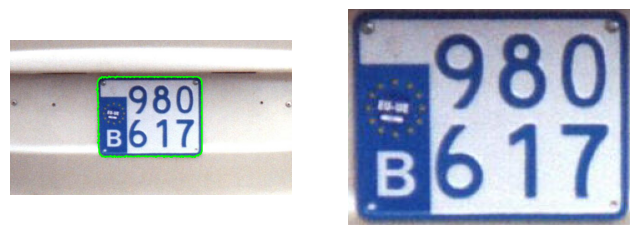

---DETECCIÓN DE NUMEROS---
Negro: 13572.0   Blanco: 25526.0
Area Promedio 804.6347826086957


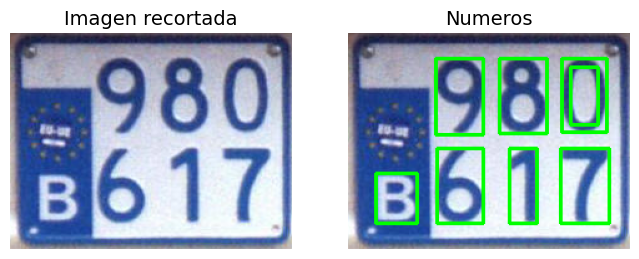

Filename: images177.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 259
Extend: 0.9795657814829128
Area: 70971.5
Area Imagen: 198000
Porcentaje de la placa: 0.3584419191919192


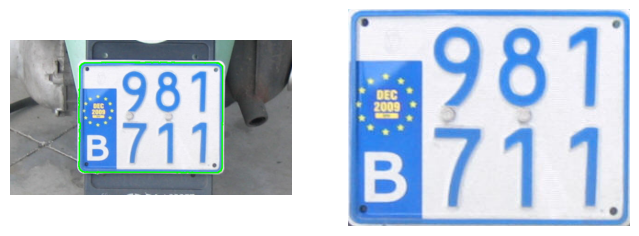

---DETECCIÓN DE NUMEROS---
Negro: 338.0   Blanco: 72114.0
Area Promedio 1187.7364864864865


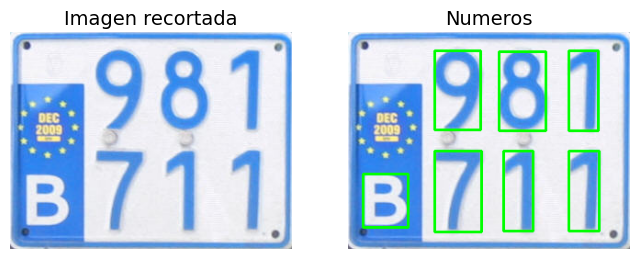

Filename: images178.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 834
Extend: 0.8303030303030303
Area: 274.0
Area Imagen: 198000
Porcentaje de la placa: 0.001383838383838384


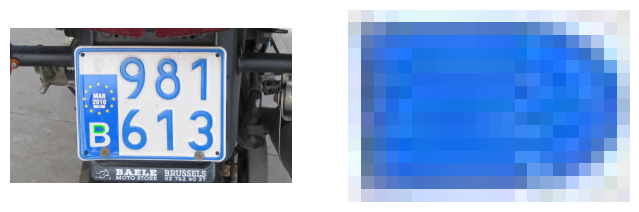

---DETECCIÓN DE NUMEROS---
Negro: 32.0   Blanco: 298.0
Area Promedio 260.0


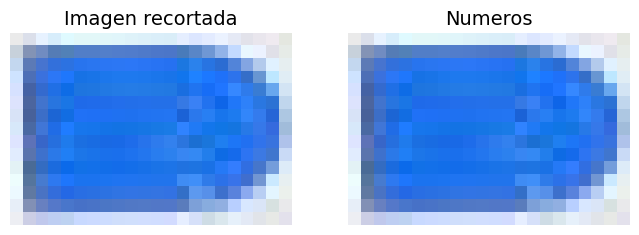

Filename: images179.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 308
Extend: 0.8983629642668545
Area: 51036.0
Area Imagen: 198000
Porcentaje de la placa: 0.25775757575757574


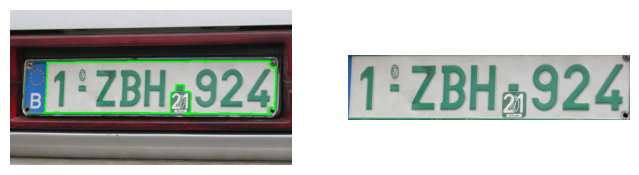

---DETECCIÓN DE NUMEROS---
Negro: 2988.0   Blanco: 53822.0
Area Promedio 748.4700854700855


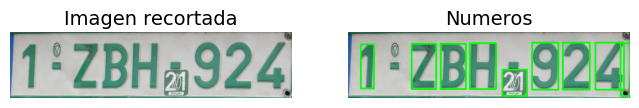

Filename: images18.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 542
Extend: 0.8948628607165192
Area: 50081.0
Area Imagen: 198000
Porcentaje de la placa: 0.25293434343434346


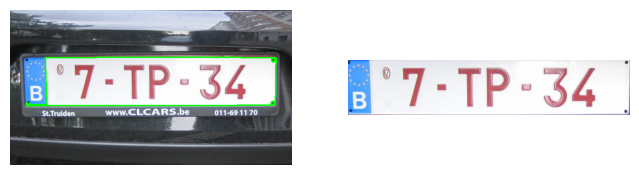

---DETECCIÓN DE NUMEROS---
Negro: 202.0   Blanco: 55763.0
Area Promedio 1017.4180327868852


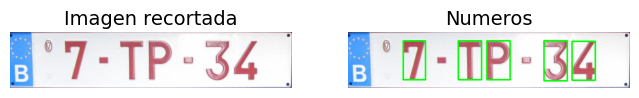

Filename: images180.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 605
Extend: 0.9600332327605055
Area: 43910.0
Area Imagen: 198000
Porcentaje de la placa: 0.22176767676767678


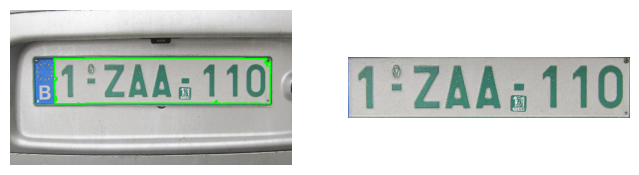

---DETECCIÓN DE NUMEROS---
Negro: 2715.0   Blanco: 43023.0
Area Promedio 237.90188679245284


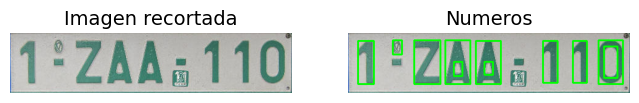

Filename: images181.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 855
Extend: 0.8317307692307693
Area: 432.5
Area Imagen: 198000
Porcentaje de la placa: 0.0021843434343434345


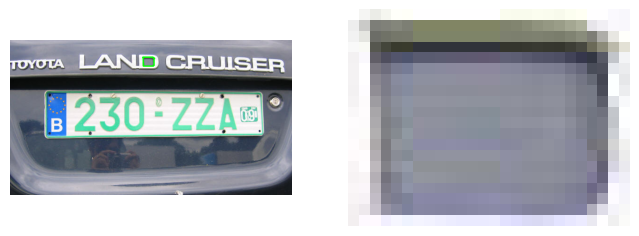

---DETECCIÓN DE NUMEROS---
Negro: 48.0   Blanco: 472.0
Area Promedio 258.0


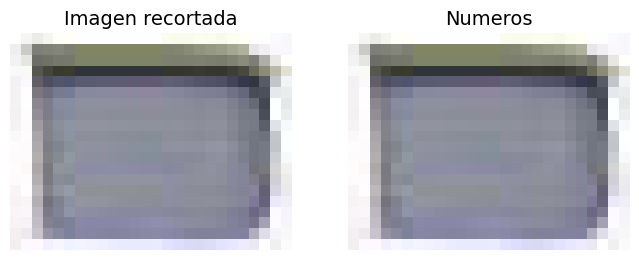

Filename: images182.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 303
Extend: 0.8208863636363637
Area: 162535.5
Area Imagen: 198000
Porcentaje de la placa: 0.8208863636363637


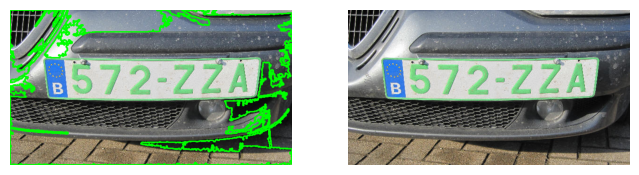

---DETECCIÓN DE NUMEROS---
Negro: 77033.0   Blanco: 120967.0
Area Promedio 106.61586901763224


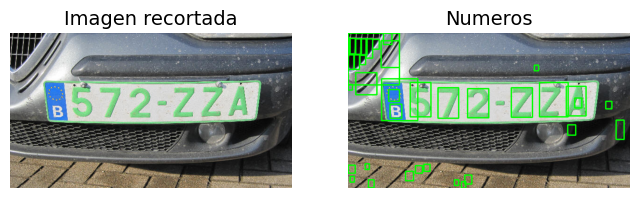

Filename: images183.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 473
Extend: 0.8429824561403508
Area: 2402.5
Area Imagen: 198000
Porcentaje de la placa: 0.012133838383838384


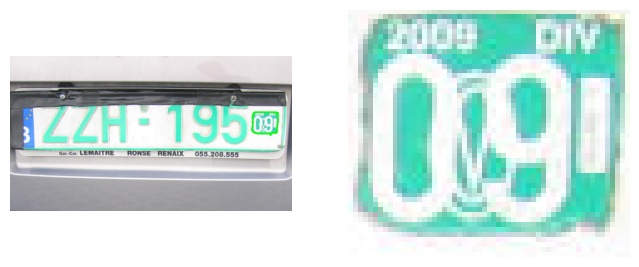

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 2850.0
Area Promedio 285.1666666666667


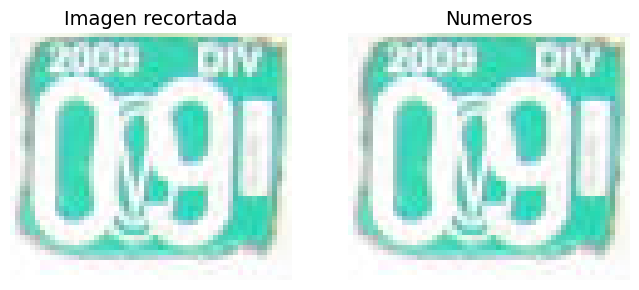

Filename: images184.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 360
Extend: 0.8851463577730322
Area: 41034.5
Area Imagen: 198000
Porcentaje de la placa: 0.20724494949494948


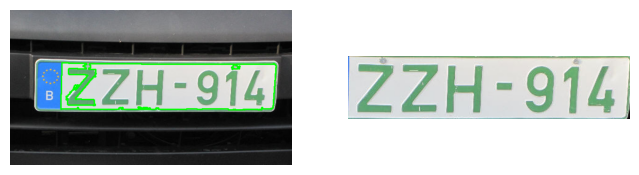

---DETECCIÓN DE NUMEROS---
Negro: 49.0   Blanco: 46310.0
Area Promedio 559.3461538461538


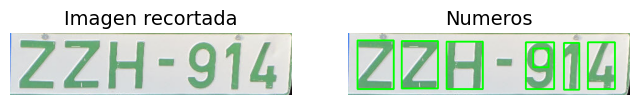

Filename: images185.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 447
Extend: 0.675
Area: 202.5
Area Imagen: 198000
Porcentaje de la placa: 0.0010227272727272728


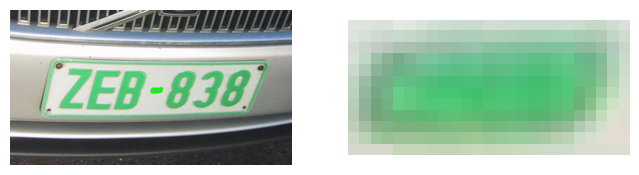

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 300.0
Area Promedio 230.0


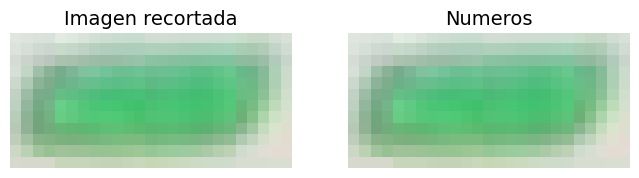

Filename: images186.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 128
Extend: 0.9446513265154883
Area: 50988.5
Area Imagen: 198000
Porcentaje de la placa: 0.2575176767676768


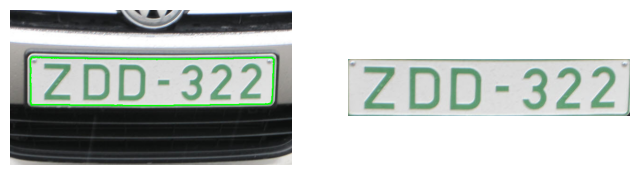

---DETECCIÓN DE NUMEROS---
Negro: 19.0   Blanco: 53957.0
Area Promedio 2325.8285714285716


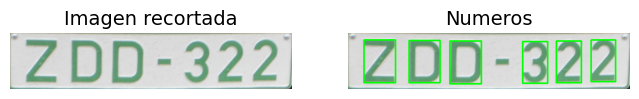

Filename: images187.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 967
Extend: 0.854390243902439
Area: 1751.5
Area Imagen: 198000
Porcentaje de la placa: 0.008845959595959596


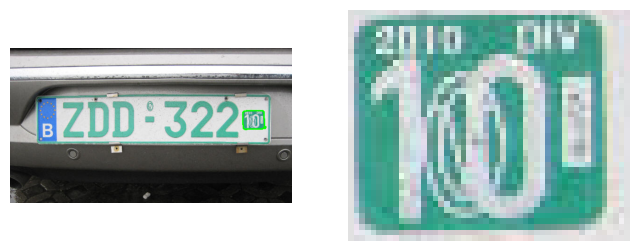

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 2050.0
Area Promedio 171.47619047619048


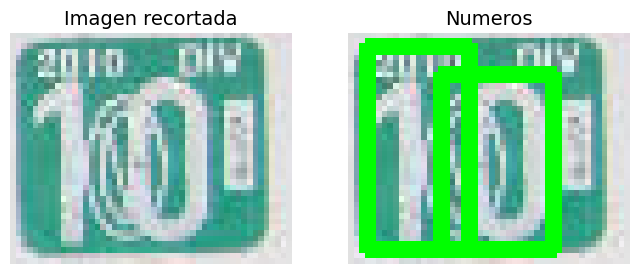

Filename: images188.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 222
Extend: 0.9152234467724355
Area: 75570.0
Area Imagen: 198000
Porcentaje de la placa: 0.38166666666666665


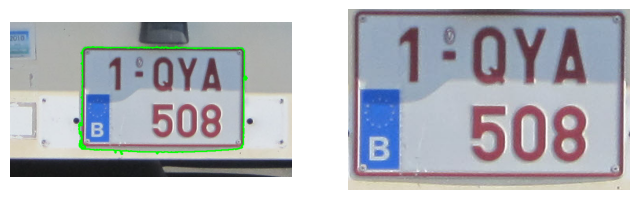

---DETECCIÓN DE NUMEROS---
Negro: 10579.0   Blanco: 71991.0
Area Promedio 1423.7175572519084


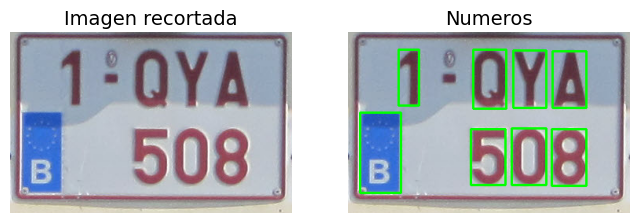

Filename: images189.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 4145
Extend: 0.9143939393939394
Area: 31382.0
Area Imagen: 198000
Porcentaje de la placa: 0.1584949494949495


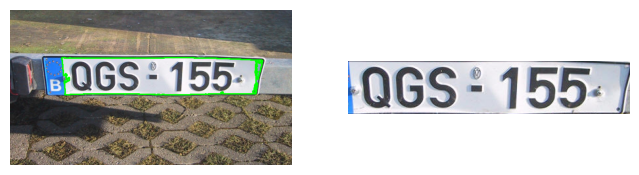

---DETECCIÓN DE NUMEROS---
Negro: 7945.0   Blanco: 26375.0
Area Promedio 469.38961038961037


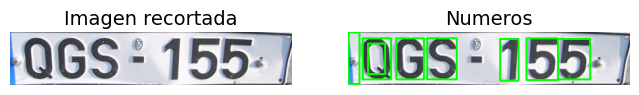

Filename: images19.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 913
Extend: 0.9226128984651711
Area: 50013.0
Area Imagen: 198000
Porcentaje de la placa: 0.2525909090909091


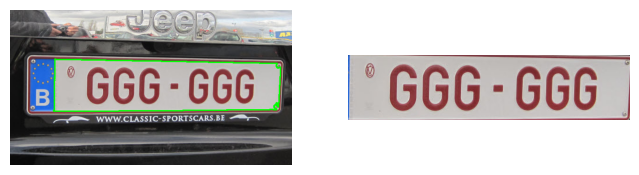

---DETECCIÓN DE NUMEROS---
Negro: 11102.0   Blanco: 43106.0
Area Promedio 1757.0285714285715


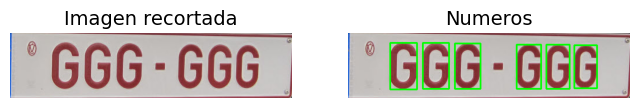

Filename: images190.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 71
Extend: 0.9583417135961384
Area: 57178.5
Area Imagen: 198000
Porcentaje de la placa: 0.28878030303030305


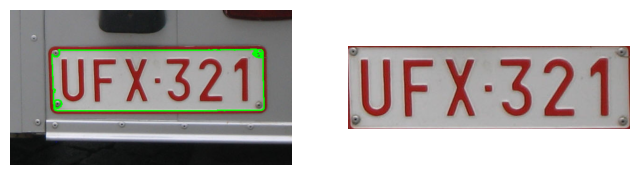

---DETECCIÓN DE NUMEROS---
Negro: 11644.0   Blanco: 48020.0
Area Promedio 2452.3333333333335


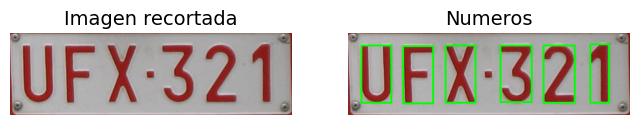

Filename: images191.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 212
Extend: 0.8662637091102621
Area: 91150.0
Area Imagen: 198000
Porcentaje de la placa: 0.46035353535353535


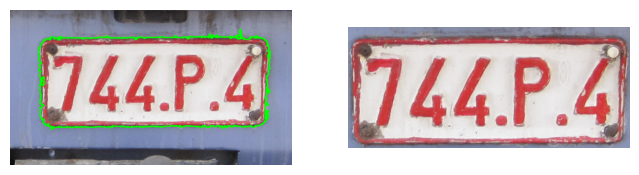

---DETECCIÓN DE NUMEROS---
Negro: 9382.0   Blanco: 95840.0
Area Promedio 592.9197994987469


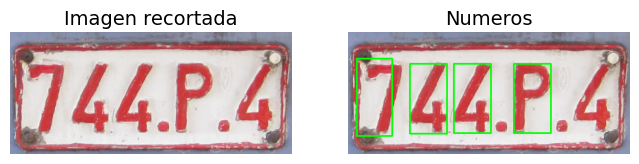

Filename: images192.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 343
Extend: 0.6842948717948718
Area: 213.5
Area Imagen: 198000
Porcentaje de la placa: 0.0010782828282828282


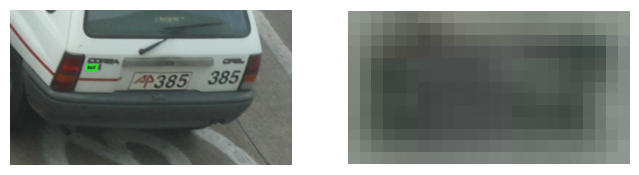

---DETECCIÓN DE NUMEROS---
Negro: 176.0   Blanco: 136.0
Area Promedio 264.0


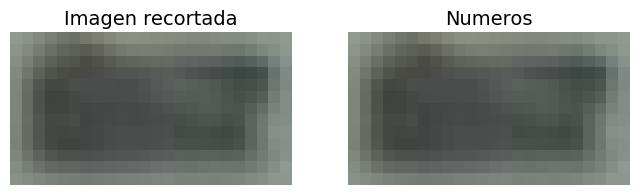

Filename: images193.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1179
Extend: 0.7717647058823529
Area: 328.0
Area Imagen: 198000
Porcentaje de la placa: 0.0016565656565656565


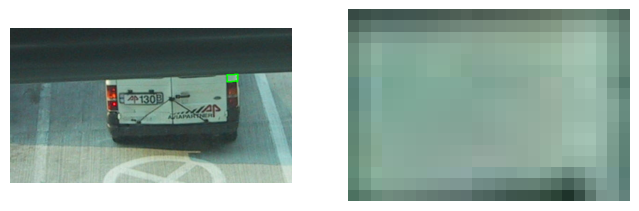

---DETECCIÓN DE NUMEROS---
Negro: 29.0   Blanco: 396.0
Area Promedio 21.2


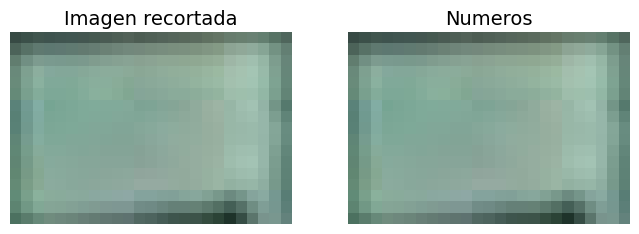

Filename: images194.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 182
Extend: 0.5357142857142857
Area: 15.0
Area Imagen: 198000
Porcentaje de la placa: 7.575757575757576e-05


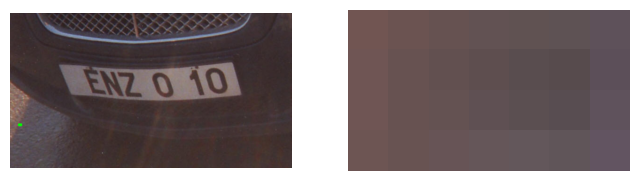

---DETECCIÓN DE NUMEROS---
Negro: 28.0   Blanco: 0.0
Area Promedio 8.0


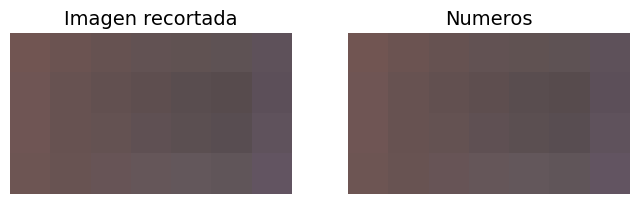

Filename: images195.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1186
Extend: 0.7399553571428571
Area: 2983.5
Area Imagen: 198000
Porcentaje de la placa: 0.015068181818181817


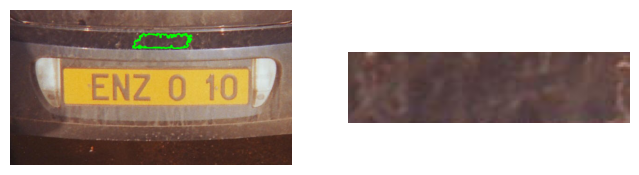

---DETECCIÓN DE NUMEROS---
Negro: 3947.0   Blanco: 85.0
Area Promedio 28.615384615384617


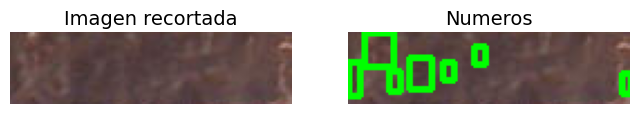

Filename: images196.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 920
Extend: 0.7906285714285715
Area: 3459.0
Area Imagen: 198000
Porcentaje de la placa: 0.01746969696969697


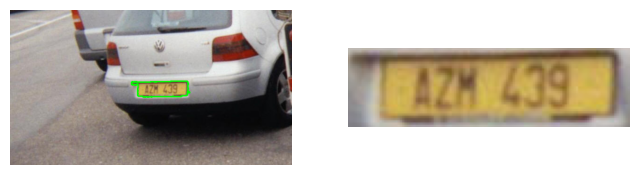

---DETECCIÓN DE NUMEROS---
Negro: 379.0   Blanco: 3996.0
Area Promedio 837.3


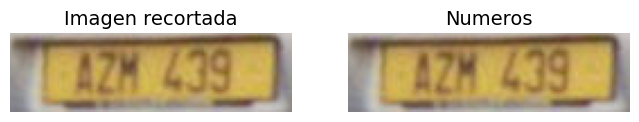

Filename: images197.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 282
Extend: 0.9124401913875598
Area: 13349.0
Area Imagen: 198000
Porcentaje de la placa: 0.06741919191919192


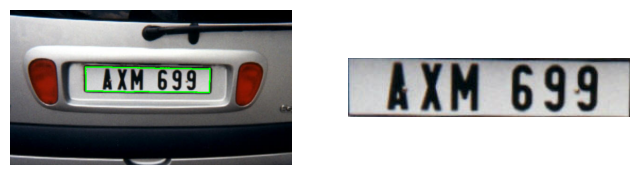

---DETECCIÓN DE NUMEROS---
Negro: 4287.0   Blanco: 10343.0
Area Promedio 1344.125


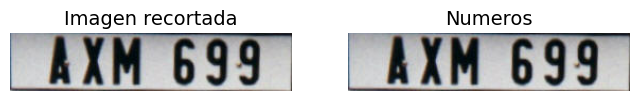

Filename: images198.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 724
Extend: 0.7347148736037625
Area: 19996.0
Area Imagen: 198000
Porcentaje de la placa: 0.10098989898989899


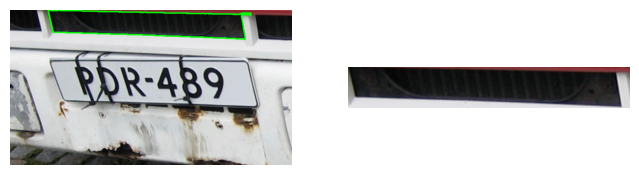

---DETECCIÓN DE NUMEROS---
Negro: 21859.0   Blanco: 5357.0
Area Promedio 503.2736842105263


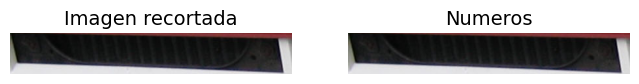

Filename: images20.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 157
Extend: 0.9662853231641733
Area: 49411.0
Area Imagen: 198000
Porcentaje de la placa: 0.24955050505050505


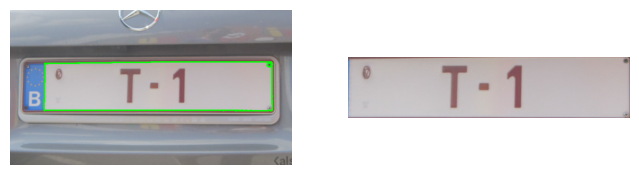

---DETECCIÓN DE NUMEROS---
Negro: 594.0   Blanco: 50541.0
Area Promedio 2497.764705882353


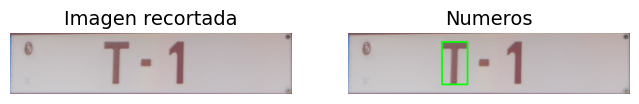

Filename: images21.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 178
Extend: 0.9485399370168909
Area: 53012.0
Area Imagen: 198000
Porcentaje de la placa: 0.2677373737373737


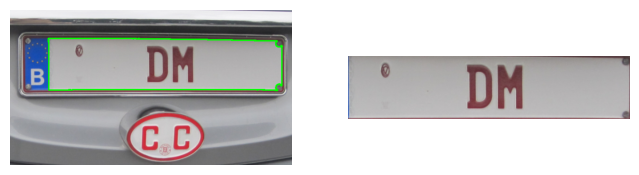

---DETECCIÓN DE NUMEROS---
Negro: 5232.0   Blanco: 50656.0
Area Promedio 4942.333333333333


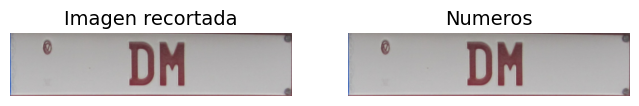

Filename: images22.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 385
Extend: 0.939491083951112
Area: 37512.0
Area Imagen: 198000
Porcentaje de la placa: 0.18945454545454546


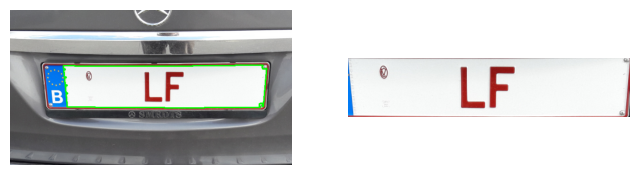

---DETECCIÓN DE NUMEROS---
Negro: 2617.0   Blanco: 37311.0
Area Promedio 1187.179487179487


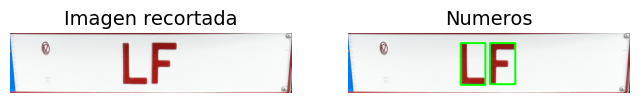

Filename: images23.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 4383
Extend: 0.9132522796352583
Area: 45069.0
Area Imagen: 198000
Porcentaje de la placa: 0.2276212121212121


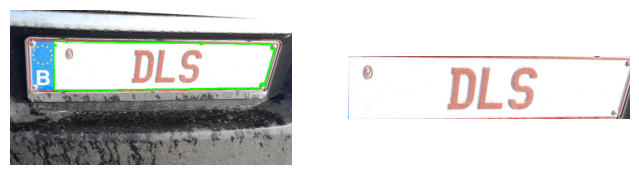

---DETECCIÓN DE NUMEROS---
Negro: 357.0   Blanco: 48993.0
Area Promedio 127.1


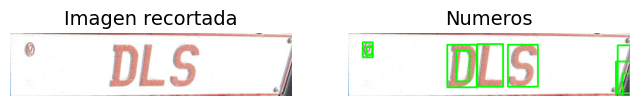

Filename: images24.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 380
Extend: 0.9614063965733907
Area: 54318.5
Area Imagen: 198000
Porcentaje de la placa: 0.27433585858585857


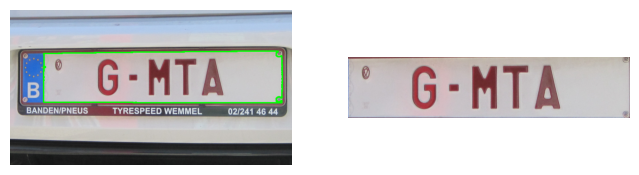

---DETECCIÓN DE NUMEROS---
Negro: 6502.0   Blanco: 49997.0
Area Promedio 252.8815789473684


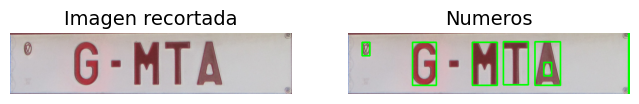

Filename: images25.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 302
Extend: 0.9450757575757576
Area: 39920.0
Area Imagen: 198000
Porcentaje de la placa: 0.2016161616161616


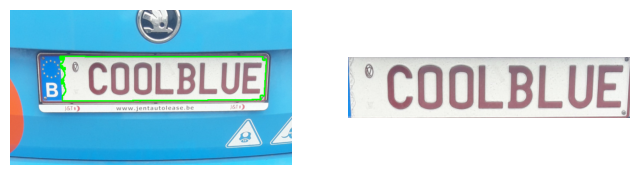

---DETECCIÓN DE NUMEROS---
Negro: 398.0   Blanco: 41842.0
Area Promedio 530.4716981132076


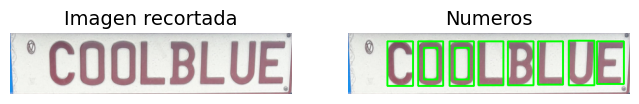

Filename: images26.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 299
Extend: 0.9200757575757575
Area: 2429.0
Area Imagen: 198000
Porcentaje de la placa: 0.012267676767676768


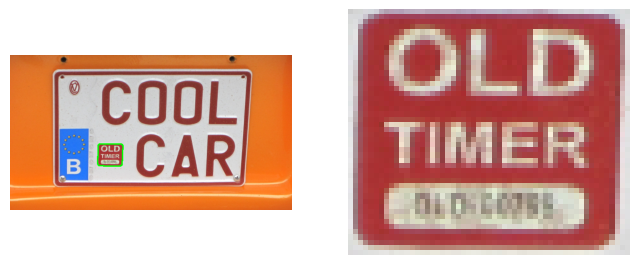

---DETECCIÓN DE NUMEROS---
Negro: 1207.0   Blanco: 1433.0
Area Promedio 169.32


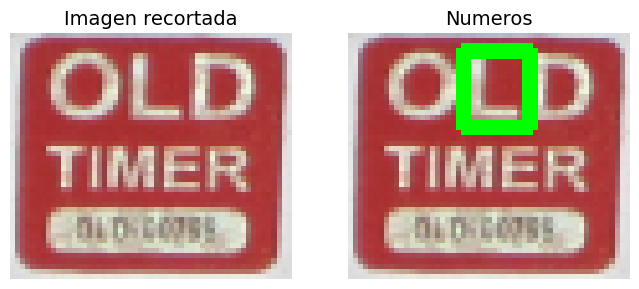

Filename: images27.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1051
Extend: 0.8810914552736983
Area: 47515.5
Area Imagen: 198000
Porcentaje de la placa: 0.23997727272727273


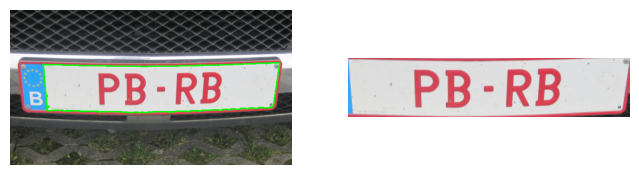

---DETECCIÓN DE NUMEROS---
Negro: 763.0   Blanco: 53165.0
Area Promedio 1015.5428571428571


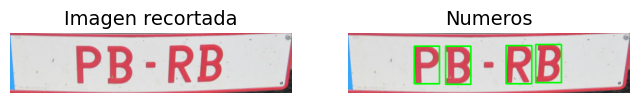

Filename: images28.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 387
Extend: 0.9525582765294959
Area: 45277.0
Area Imagen: 198000
Porcentaje de la placa: 0.22867171717171716


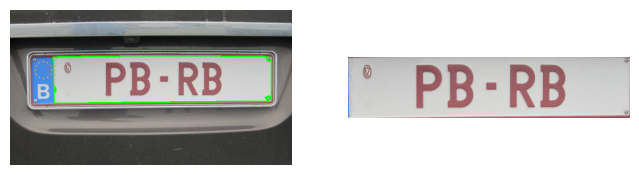

---DETECCIÓN DE NUMEROS---
Negro: 699.0   Blanco: 46833.0
Area Promedio 1370.2307692307693


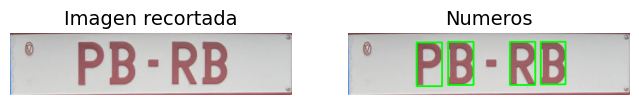

Filename: images29.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 592
Extend: 0.9517131776747161
Area: 47608.5
Area Imagen: 198000
Porcentaje de la placa: 0.2404469696969697


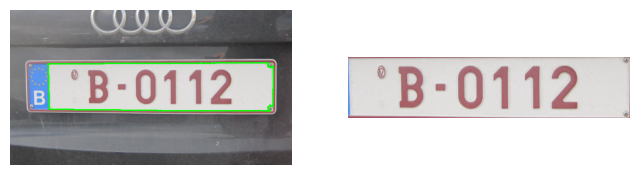

---DETECCIÓN DE NUMEROS---
Negro: 1.0   Blanco: 50023.0
Area Promedio 521.5945945945946


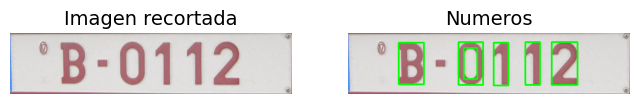

Filename: images3.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 44
Extend: 0.9470176172303831
Area: 54346.5
Area Imagen: 198000
Porcentaje de la placa: 0.27447727272727274


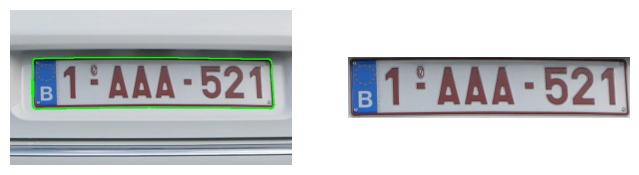

---DETECCIÓN DE NUMEROS---
Negro: 18373.0   Blanco: 39014.0
Area Promedio 1036.258064516129


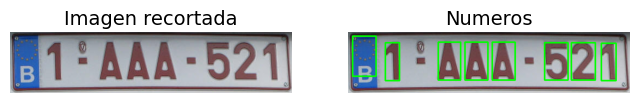

Filename: images30.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 729
Extend: 0.9396725106253795
Area: 49524.5
Area Imagen: 198000
Porcentaje de la placa: 0.2501237373737374


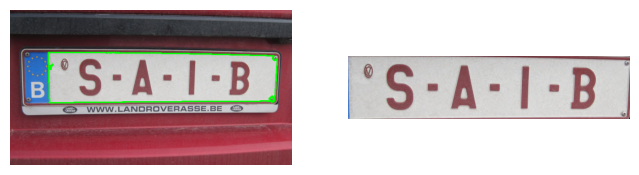

---DETECCIÓN DE NUMEROS---
Negro: 5749.0   Blanco: 46955.0
Area Promedio 279.57547169811323


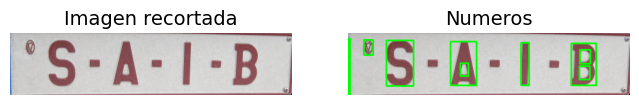

Filename: images31.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 580
Extend: 0.9814583488701618
Area: 52641.5
Area Imagen: 198000
Porcentaje de la placa: 0.2658661616161616


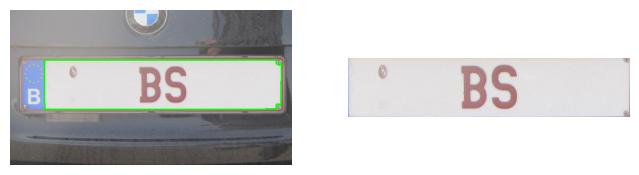

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 53636.0
Area Promedio 130.6578947368421


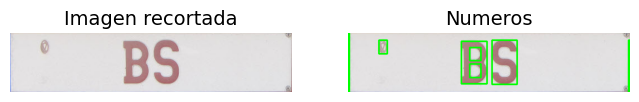

Filename: images32.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 44
Extend: 0.7180451127819549
Area: 191.0
Area Imagen: 198000
Porcentaje de la placa: 0.0009646464646464646


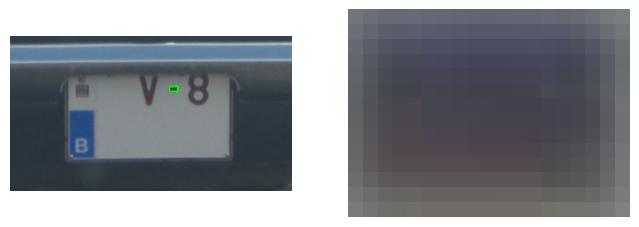

---DETECCIÓN DE NUMEROS---
Negro: 191.0   Blanco: 75.0
Area Promedio 187.0


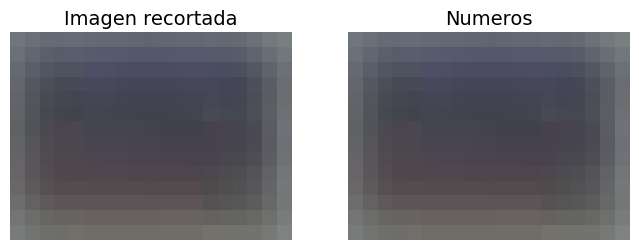

Filename: images33.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 195
Extend: 0.8815579071134627
Area: 74976.5
Area Imagen: 198000
Porcentaje de la placa: 0.3786691919191919


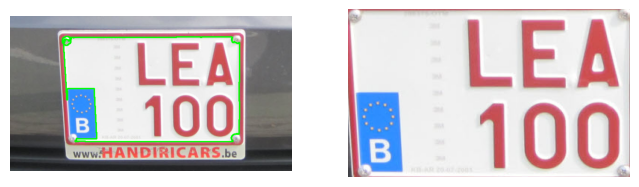

---DETECCIÓN DE NUMEROS---
Negro: 136.0   Blanco: 84914.0
Area Promedio 1341.6701030927834


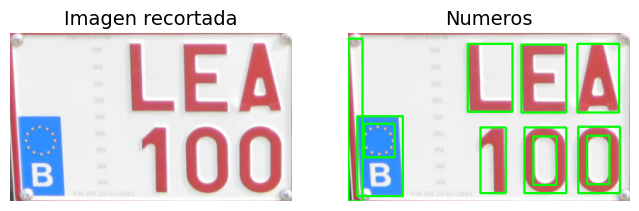

Filename: images34.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 206
Extend: 0.8869499568593615
Area: 82238.0
Area Imagen: 198000
Porcentaje de la placa: 0.41534343434343435


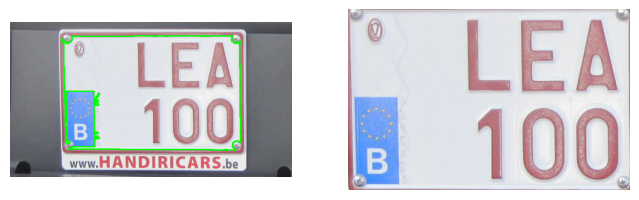

---DETECCIÓN DE NUMEROS---
Negro: 9.0   Blanco: 92711.0
Area Promedio 411.18324607329845


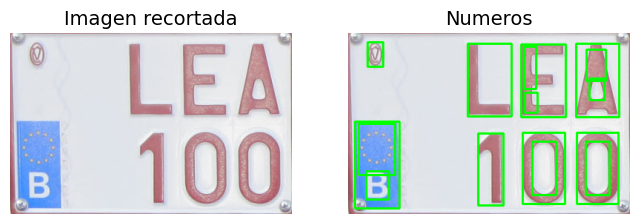

Filename: images35.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 906
Extend: 0.9730218805440568
Area: 41134.5
Area Imagen: 198000
Porcentaje de la placa: 0.20775


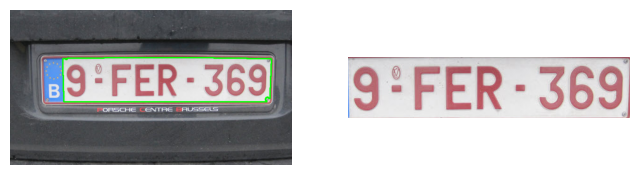

---DETECCIÓN DE NUMEROS---
Negro: 32.0   Blanco: 42243.0
Area Promedio 384.953125


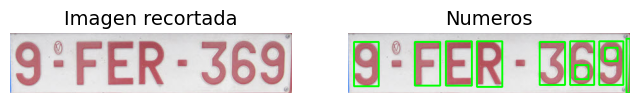

Filename: images36.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 86
Extend: 0.882479240806643
Area: 148786.0
Area Imagen: 198000
Porcentaje de la placa: 0.7514444444444445


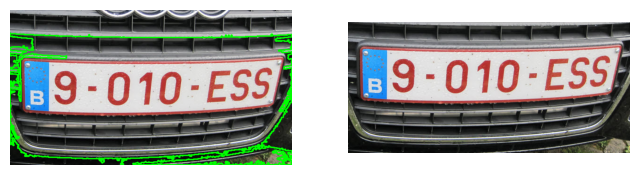

---DETECCIÓN DE NUMEROS---
Negro: 78033.0   Blanco: 90567.0
Area Promedio 635.3699346405228


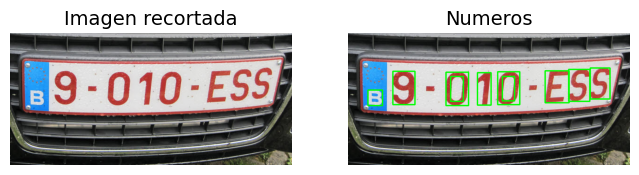

Filename: images37.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 533
Extend: 0.9437760350003491
Area: 40555.0
Area Imagen: 198000
Porcentaje de la placa: 0.20482323232323232


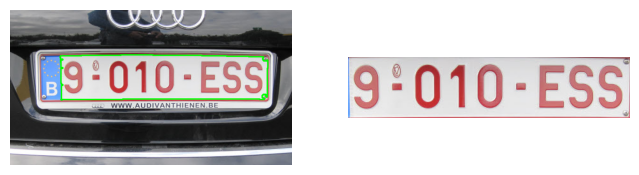

---DETECCIÓN DE NUMEROS---
Negro: 2147.0   Blanco: 40824.0
Area Promedio 826.0882352941177


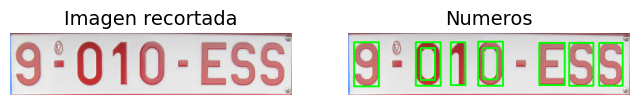

Filename: images38.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 529
Extend: 0.8786291581393736
Area: 75990.0
Area Imagen: 198000
Porcentaje de la placa: 0.3837878787878788


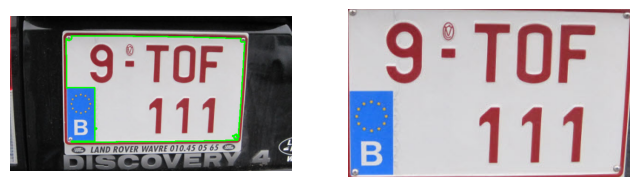

---DETECCIÓN DE NUMEROS---
Negro: 11570.0   Blanco: 74917.0
Area Promedio 1345.9493670886077


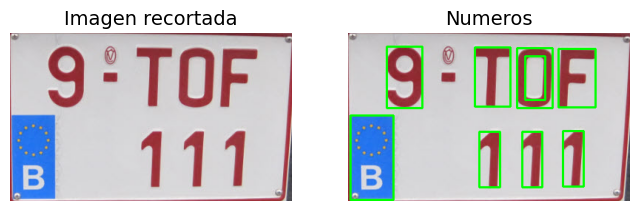

Filename: images39.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 458
Extend: 0.9007009019574991
Area: 64510.0
Area Imagen: 198000
Porcentaje de la placa: 0.3258080808080808


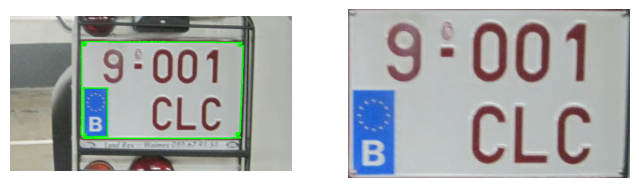

---DETECCIÓN DE NUMEROS---
Negro: 9659.0   Blanco: 61963.0
Area Promedio 1394.4


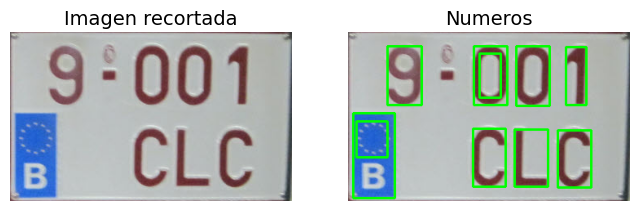

Filename: images4.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 412
Extend: 0.971257049299618
Area: 90763.0
Area Imagen: 198000
Porcentaje de la placa: 0.4583989898989899


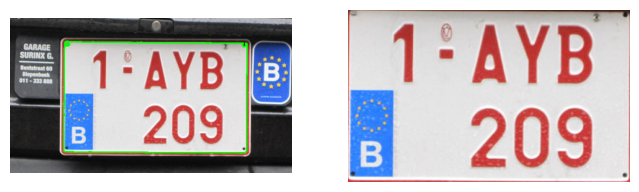

---DETECCIÓN DE NUMEROS---
Negro: 6366.0   Blanco: 87083.0
Area Promedio 901.8618421052631


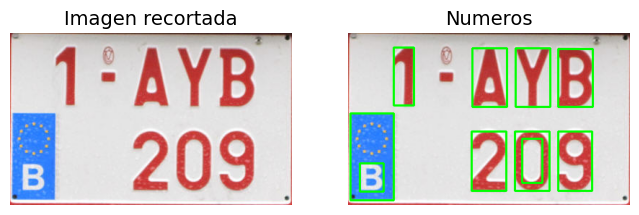

Filename: images40.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 53
Extend: 0.9608088818398097
Area: 60579.0
Area Imagen: 198000
Porcentaje de la placa: 0.3059545454545455


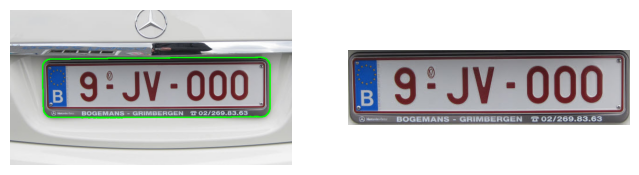

---DETECCIÓN DE NUMEROS---
Negro: 24322.0   Blanco: 38728.0
Area Promedio 1500.2716049382716


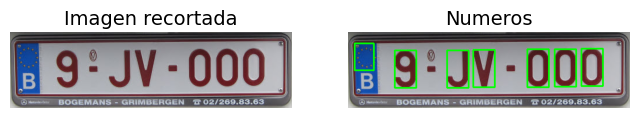

Filename: images41.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 811
Extend: 0.9246826275879697
Area: 43412.0
Area Imagen: 198000
Porcentaje de la placa: 0.21925252525252525


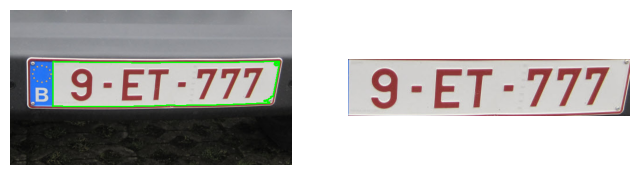

---DETECCIÓN DE NUMEROS---
Negro: 8209.0   Blanco: 38739.0
Area Promedio 1294.65


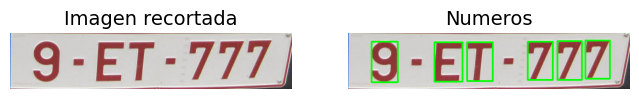

Filename: images42.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 978
Extend: 0.9389275074478649
Area: 49166.0
Area Imagen: 198000
Porcentaje de la placa: 0.24831313131313132


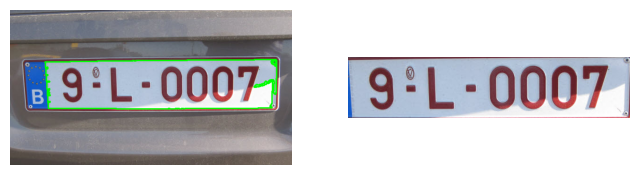

---DETECCIÓN DE NUMEROS---
Negro: 10534.0   Blanco: 41830.0
Area Promedio 908.974025974026


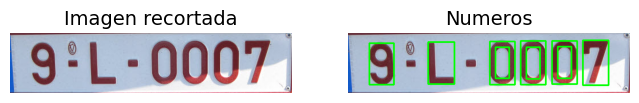

Filename: images43.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 981
Extend: 0.8492545047303848
Area: 50807.5
Area Imagen: 198000
Porcentaje de la placa: 0.25660353535353536


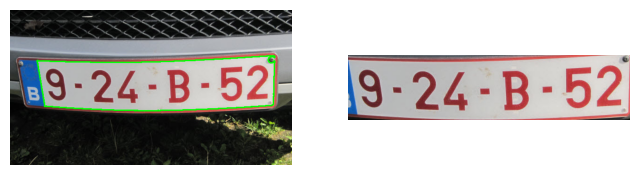

---DETECCIÓN DE NUMEROS---
Negro: 9468.0   Blanco: 50358.0
Area Promedio 1333.032258064516


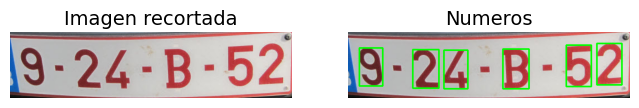

Filename: images44.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 21
Extend: 0.9474998877363151
Area: 84399.5
Area Imagen: 198000
Porcentaje de la placa: 0.42626010101010103


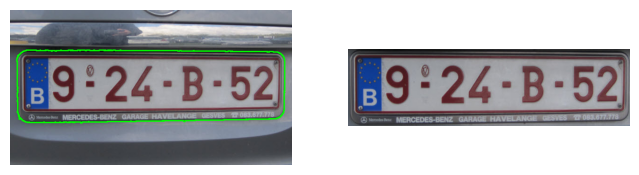

---DETECCIÓN DE NUMEROS---
Negro: 36584.0   Blanco: 52492.0
Area Promedio 1802.8758620689655


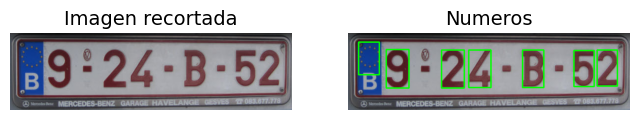

Filename: images45.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 294
Extend: 0.9546882901105251
Area: 52863.0
Area Imagen: 198000
Porcentaje de la placa: 0.2669848484848485


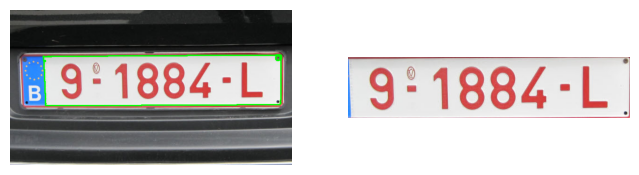

---DETECCIÓN DE NUMEROS---
Negro: 523.0   Blanco: 54849.0
Area Promedio 4449.689655172414


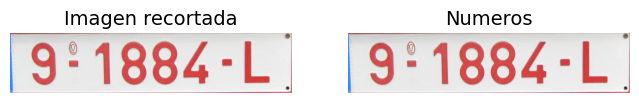

Filename: images46.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 537
Extend: 0.9345819397993311
Area: 41916.0
Area Imagen: 198000
Porcentaje de la placa: 0.2116969696969697


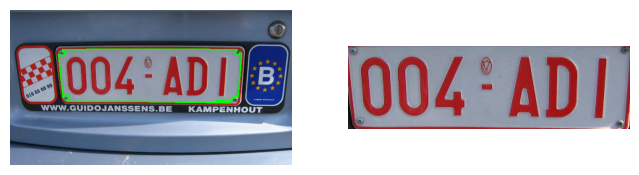

---DETECCIÓN DE NUMEROS---
Negro: 11573.0   Blanco: 33277.0
Area Promedio 802.2435897435897


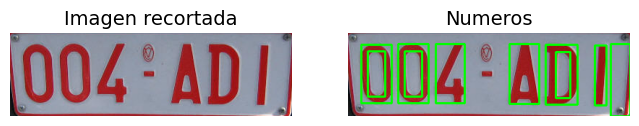

Filename: images47.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1685
Extend: 0.8876177788075379
Area: 45971.5
Area Imagen: 198000
Porcentaje de la placa: 0.23217929292929293


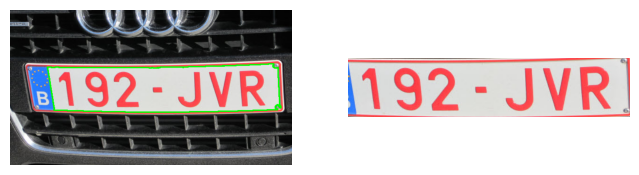

---DETECCIÓN DE NUMEROS---
Negro: 169.0   Blanco: 51623.0
Area Promedio 2359.71875


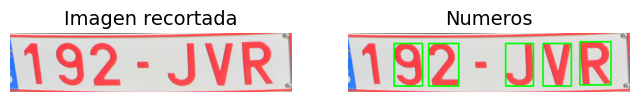

Filename: images48.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 336
Extend: 0.9644224700189354
Area: 68758.5
Area Imagen: 198000
Porcentaje de la placa: 0.3472651515151515


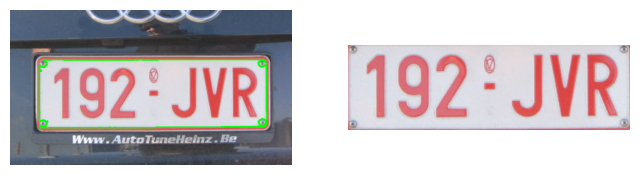

---DETECCIÓN DE NUMEROS---
Negro: 1.0   Blanco: 71294.0
Area Promedio 659.3142857142857


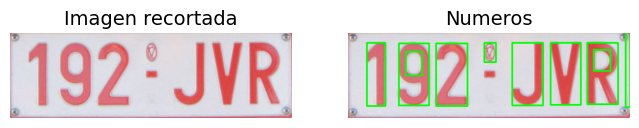

Filename: images49.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 138
Extend: 0.9161125319693094
Area: 102087.0
Area Imagen: 198000
Porcentaje de la placa: 0.5155909090909091


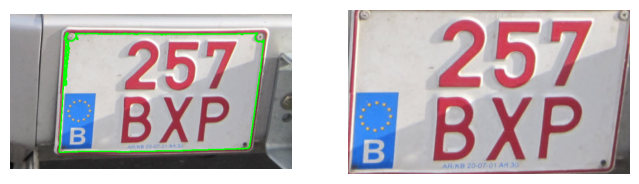

---DETECCIÓN DE NUMEROS---
Negro: 11198.0   Blanco: 100237.0
Area Promedio 787.0583333333333


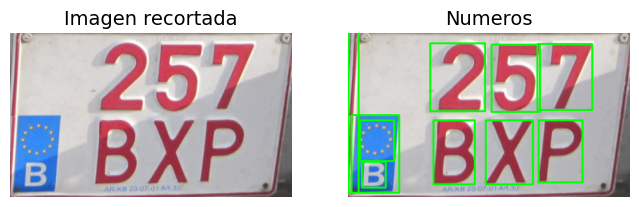

Filename: images5.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 77
Extend: 0.8240740740740741
Area: 178.0
Area Imagen: 198000
Porcentaje de la placa: 0.000898989898989899


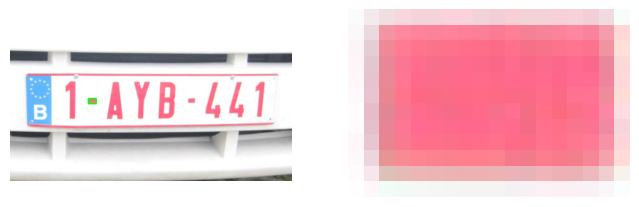

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 216.0
Area Promedio 160.0


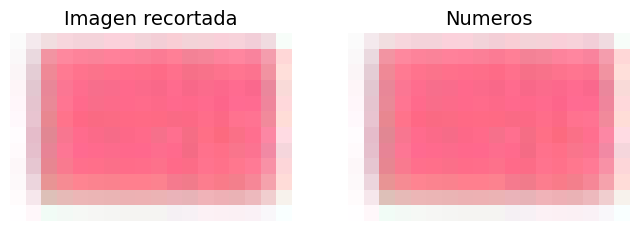

Filename: images50.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 607
Extend: 0.759515570934256
Area: 219.5
Area Imagen: 198000
Porcentaje de la placa: 0.0011085858585858585


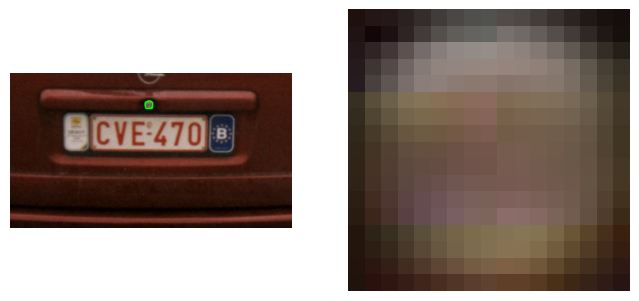

---DETECCIÓN DE NUMEROS---
Negro: 204.0   Blanco: 85.0
Area Promedio 60.666666666666664


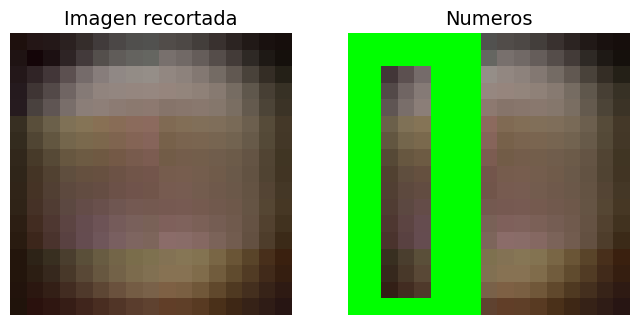

Filename: images51.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1000
Extend: 0.8666255940855483
Area: 24616.5
Area Imagen: 198000
Porcentaje de la placa: 0.12432575757575758


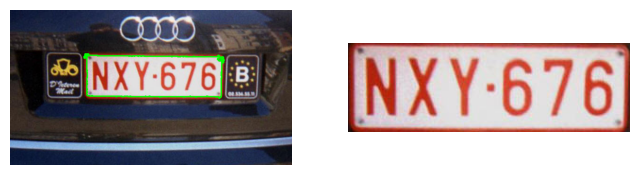

---DETECCIÓN DE NUMEROS---
Negro: 4331.0   Blanco: 24074.0
Area Promedio 3608.842105263158


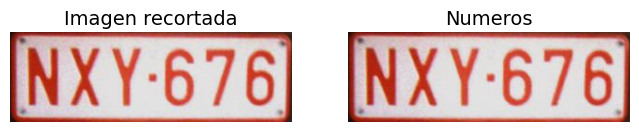

Filename: images52.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1716
Extend: 0.8288934426229508
Area: 1618.0
Area Imagen: 198000
Porcentaje de la placa: 0.008171717171717172


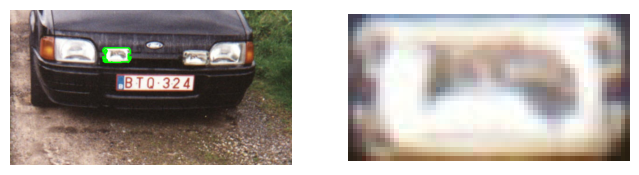

---DETECCIÓN DE NUMEROS---
Negro: 149.0   Blanco: 1803.0
Area Promedio 310.875


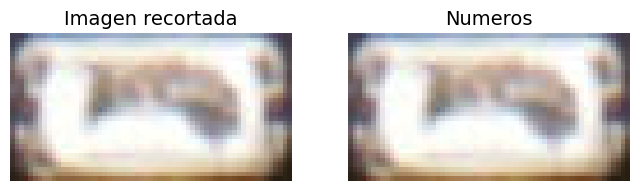

Filename: images53.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 858
Extend: 0.8199008104865846
Area: 56043.5
Area Imagen: 198000
Porcentaje de la placa: 0.2830479797979798


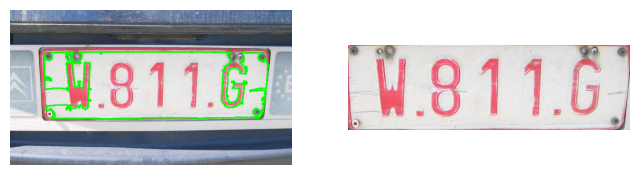

---DETECCIÓN DE NUMEROS---
Negro: 312.0   Blanco: 68042.0
Area Promedio 293.7723342939481


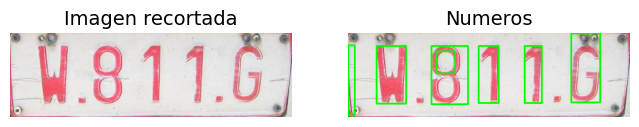

Filename: images54.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 305
Extend: 0.9496770610498602
Area: 46169.5
Area Imagen: 198000
Porcentaje de la placa: 0.23317929292929293


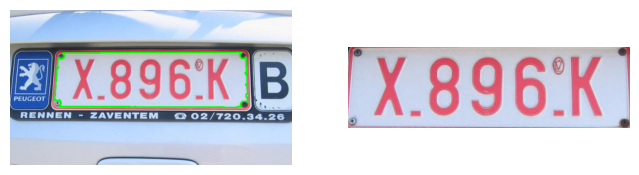

---DETECCIÓN DE NUMEROS---
Negro: 418.0   Blanco: 48198.0
Area Promedio 443.84


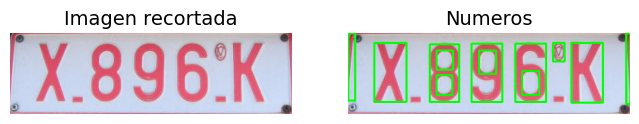

Filename: images55.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 354
Extend: 0.9548611111111112
Area: 8662.5
Area Imagen: 198000
Porcentaje de la placa: 0.04375


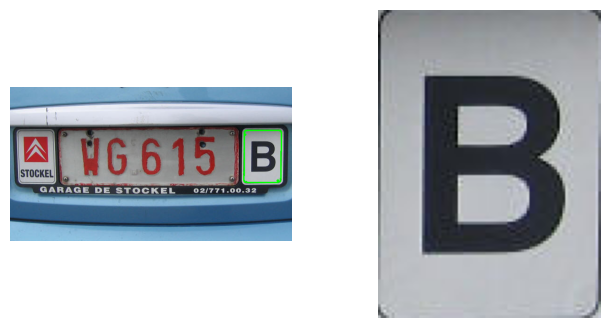

---DETECCIÓN DE NUMEROS---
Negro: 2369.0   Blanco: 6703.0
Area Promedio 264.54545454545456


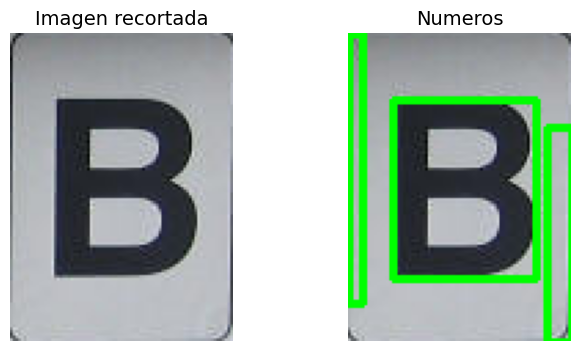

Filename: images56.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 640
Extend: 0.9607344074330335
Area: 58318.5
Area Imagen: 198000
Porcentaje de la placa: 0.2945378787878788


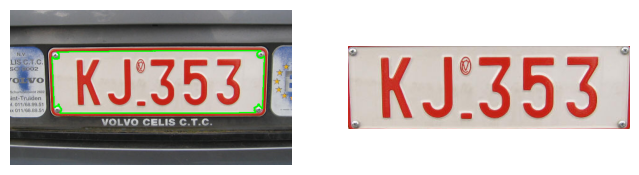

---DETECCIÓN DE NUMEROS---
Negro: 10633.0   Blanco: 50069.0
Area Promedio 308.3090909090909


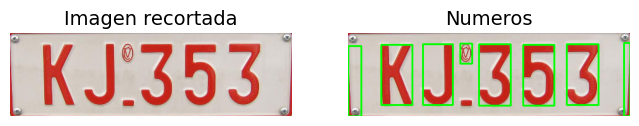

Filename: images57.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 293
Extend: 0.9525967367373406
Area: 63170.5
Area Imagen: 198000
Porcentaje de la placa: 0.31904292929292927


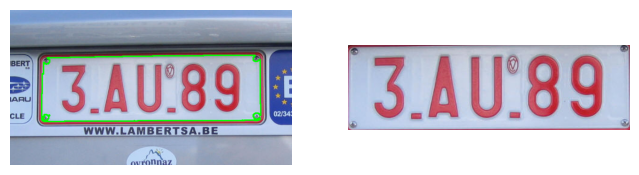

---DETECCIÓN DE NUMEROS---
Negro: 5302.0   Blanco: 61012.0
Area Promedio 481.2139303482587


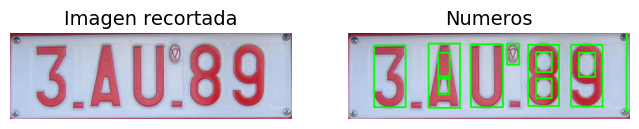

Filename: images58.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 333
Extend: 0.9602409638554217
Area: 50211.0
Area Imagen: 198000
Porcentaje de la placa: 0.2535909090909091


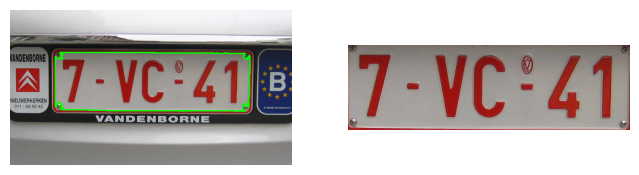

---DETECCIÓN DE NUMEROS---
Negro: 10320.0   Blanco: 41970.0
Area Promedio 250.57894736842104


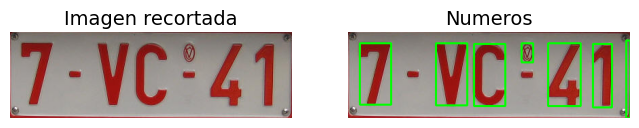

Filename: images59.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 114
Extend: 0.8424036281179138
Area: 371.5
Area Imagen: 198000
Porcentaje de la placa: 0.0018762626262626262


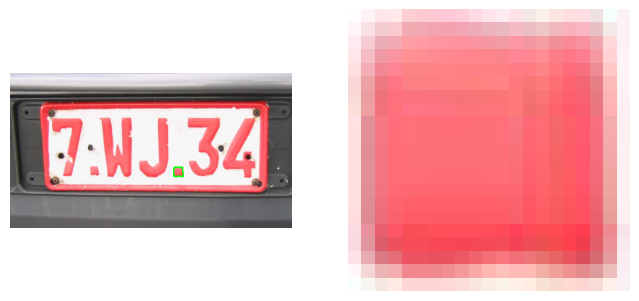

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 441.0
Area Promedio 361.0


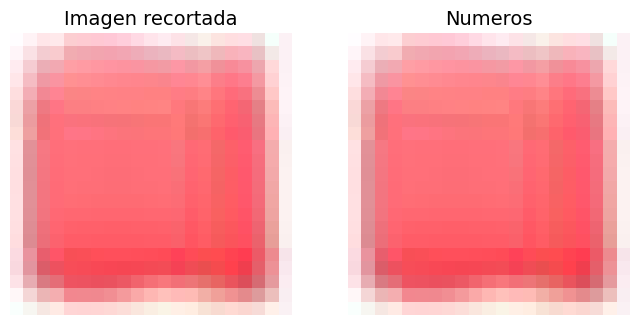

Filename: images6.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 232
Extend: 0.7375930521091811
Area: 594.5
Area Imagen: 198000
Porcentaje de la placa: 0.0030025252525252527


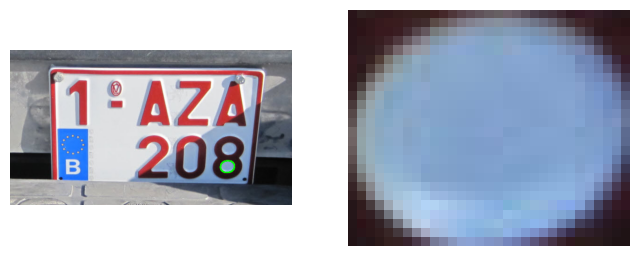

---DETECCIÓN DE NUMEROS---
Negro: 192.0   Blanco: 614.0
Area Promedio 128.4


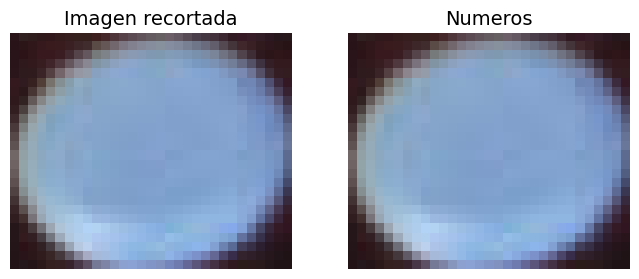

Filename: images60.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 417
Extend: 0.957925287258779
Area: 56440.0
Area Imagen: 198000
Porcentaje de la placa: 0.28505050505050505


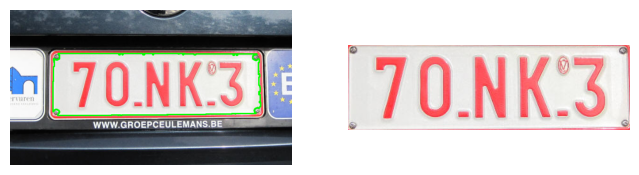

---DETECCIÓN DE NUMEROS---
Negro: 40.0   Blanco: 58879.0
Area Promedio 472.3818181818182


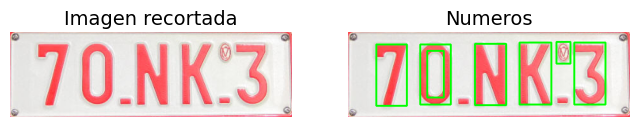

Filename: images61.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 240
Extend: 0.8833584222353121
Area: 80981.0
Area Imagen: 198000
Porcentaje de la placa: 0.4089949494949495


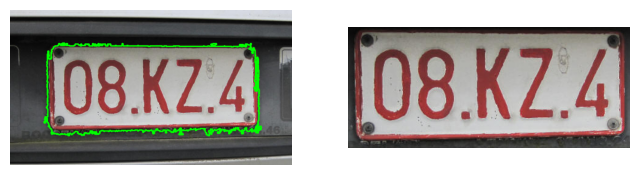

---DETECCIÓN DE NUMEROS---
Negro: 35589.0   Blanco: 56085.0
Area Promedio 533.4022556390977


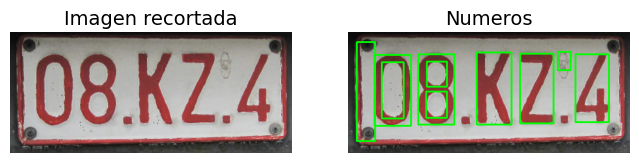

Filename: images62.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 471
Extend: 0.9434150019778481
Area: 76318.5
Area Imagen: 198000
Porcentaje de la placa: 0.3854469696969697


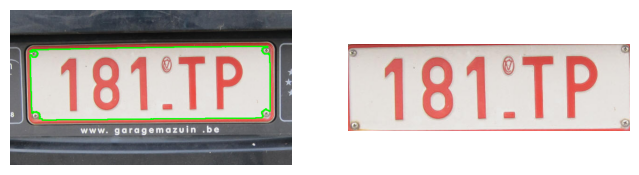

---DETECCIÓN DE NUMEROS---
Negro: 829.0   Blanco: 80067.0
Area Promedio 867.2109375


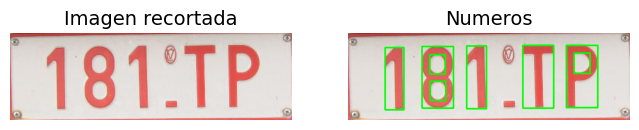

Filename: images63.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 347
Extend: 0.9214461554577834
Area: 70369.0
Area Imagen: 198000
Porcentaje de la placa: 0.3553989898989899


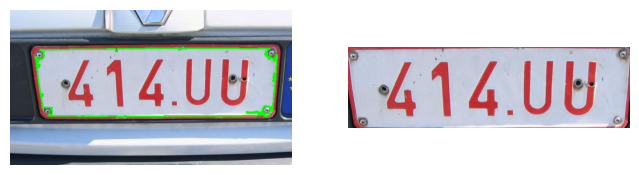

---DETECCIÓN DE NUMEROS---
Negro: 10716.0   Blanco: 65652.0
Area Promedio 369.1678832116788


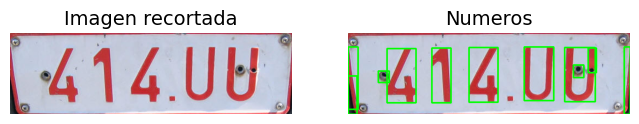

Filename: images64.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 260
Extend: 0.9381741894071047
Area: 59924.0
Area Imagen: 198000
Porcentaje de la placa: 0.30264646464646466


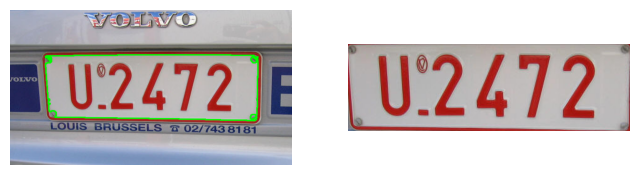

---DETECCIÓN DE NUMEROS---
Negro: 13018.0   Blanco: 50855.0
Area Promedio 1752.7021276595744


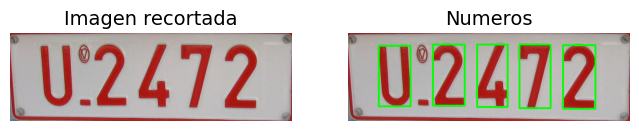

Filename: images65.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 667
Extend: 0.9717828368689482
Area: 78883.5
Area Imagen: 198000
Porcentaje de la placa: 0.3984015151515152


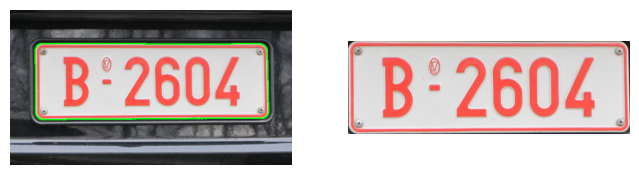

---DETECCIÓN DE NUMEROS---
Negro: 1509.0   Blanco: 79665.0
Area Promedio 2973.757575757576


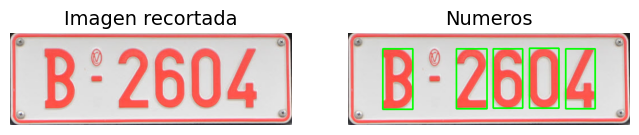

Filename: images66.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 64
Extend: 0.9605223557737524
Area: 102128.5
Area Imagen: 198000
Porcentaje de la placa: 0.515800505050505


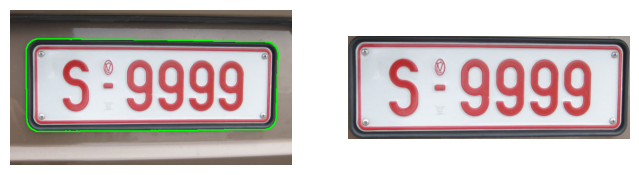

---DETECCIÓN DE NUMEROS---
Negro: 18921.0   Blanco: 87405.0
Area Promedio 4516.715596330275


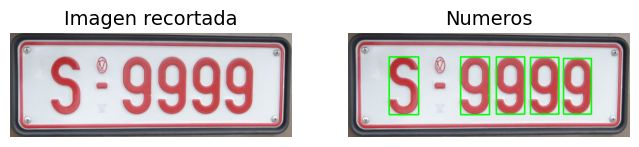

Filename: images67.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 185
Extend: 0.9463346354166666
Area: 72678.5
Area Imagen: 198000
Porcentaje de la placa: 0.3670631313131313


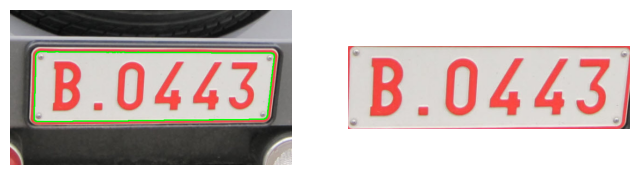

---DETECCIÓN DE NUMEROS---
Negro: 346.0   Blanco: 76454.0
Area Promedio 2045.3454545454545


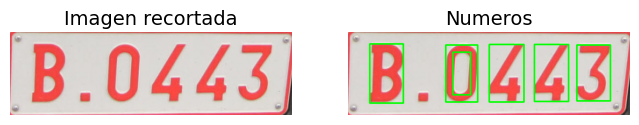

Filename: images68.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 702
Extend: 0.6784313725490196
Area: 173.0
Area Imagen: 198000
Porcentaje de la placa: 0.0008737373737373737


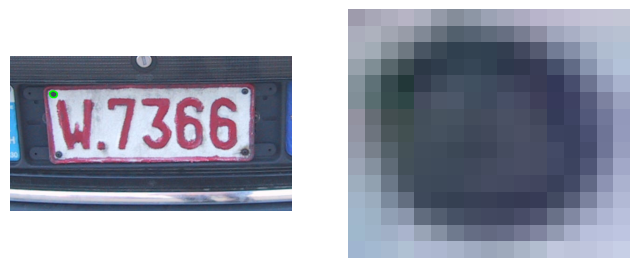

---DETECCIÓN DE NUMEROS---
Negro: 125.0   Blanco: 130.0
Area Promedio 195.0


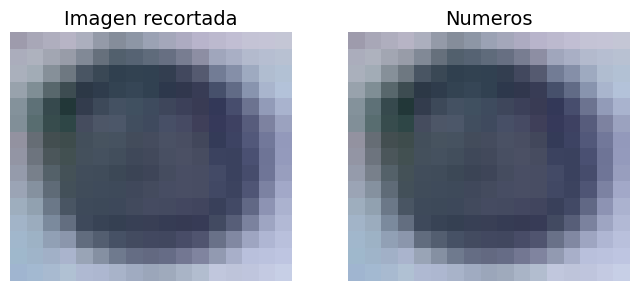

Filename: images69.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 77
Extend: 0.9077462121212121
Area: 143787.0
Area Imagen: 198000
Porcentaje de la placa: 0.7261969696969697


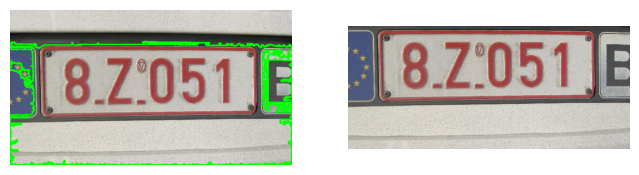

---DETECCIÓN DE NUMEROS---
Negro: 38482.0   Blanco: 119918.0
Area Promedio 89.04343675417661


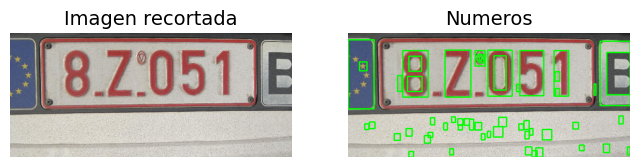

Filename: images7.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 61
Extend: 0.9755398980351722
Area: 102180.0
Area Imagen: 198000
Porcentaje de la placa: 0.5160606060606061


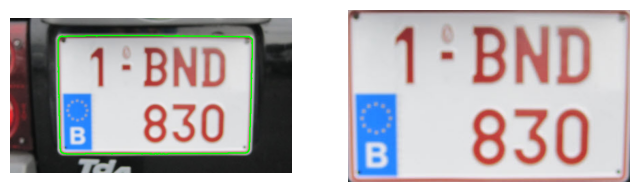

---DETECCIÓN DE NUMEROS---
Negro: 3336.0   Blanco: 101406.0
Area Promedio 3042.16


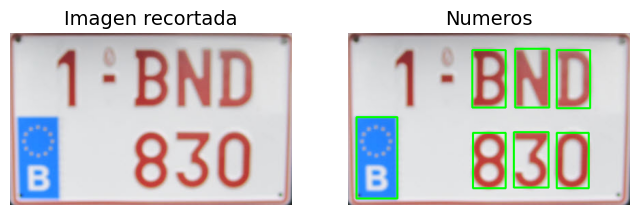

Filename: images70.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 312
Extend: 0.9331202884300229
Area: 56939.0
Area Imagen: 198000
Porcentaje de la placa: 0.2875707070707071


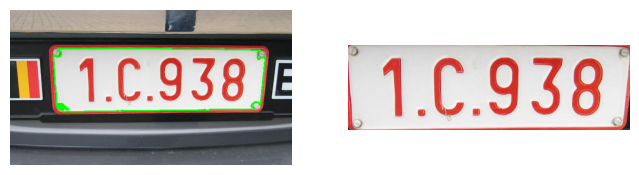

---DETECCIÓN DE NUMEROS---
Negro: 4639.0   Blanco: 56381.0
Area Promedio 823.1428571428571


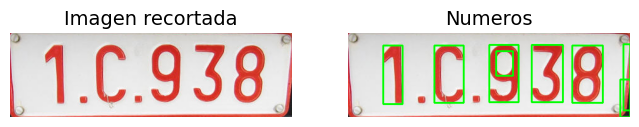

Filename: images71.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 178
Extend: 0.8910012674271229
Area: 140600.0
Area Imagen: 198000
Porcentaje de la placa: 0.7101010101010101


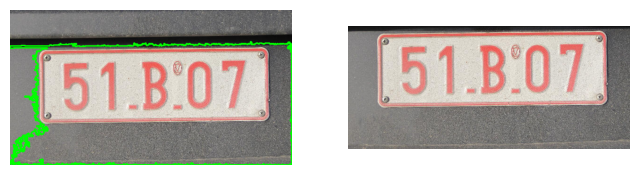

---DETECCIÓN DE NUMEROS---
Negro: 19069.0   Blanco: 138731.0
Area Promedio 65.16823759558955


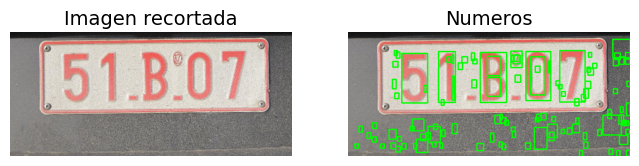

Filename: images72.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 362
Extend: 0.9345569328779215
Area: 48703.5
Area Imagen: 198000
Porcentaje de la placa: 0.24597727272727274


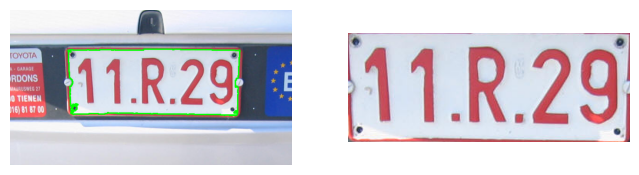

---DETECCIÓN DE NUMEROS---
Negro: 1009.0   Blanco: 51105.0
Area Promedio 1713.3529411764705


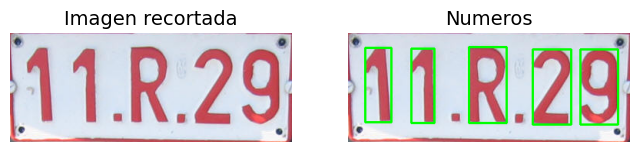

Filename: images73.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 374
Extend: 0.9605543182380599
Area: 58224.0
Area Imagen: 198000
Porcentaje de la placa: 0.2940606060606061


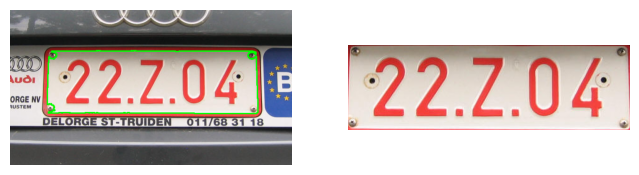

---DETECCIÓN DE NUMEROS---
Negro: 2920.0   Blanco: 57695.0
Area Promedio 1603.24


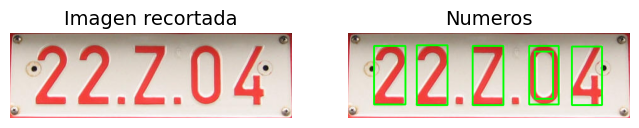

Filename: images74.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 377
Extend: 0.9533931296521224
Area: 61225.0
Area Imagen: 198000
Porcentaje de la placa: 0.3092171717171717


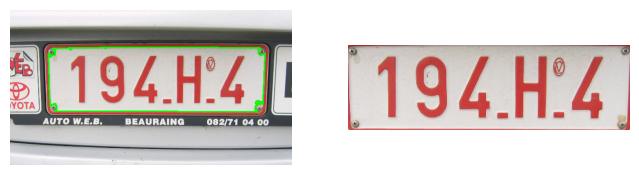

---DETECCIÓN DE NUMEROS---
Negro: 3751.0   Blanco: 60467.0
Area Promedio 857.9514563106796


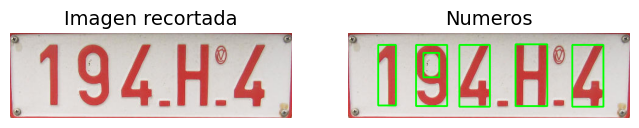

Filename: images75.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 840
Extend: 0.8891209893048129
Area: 79807.5
Area Imagen: 198000
Porcentaje de la placa: 0.4030681818181818


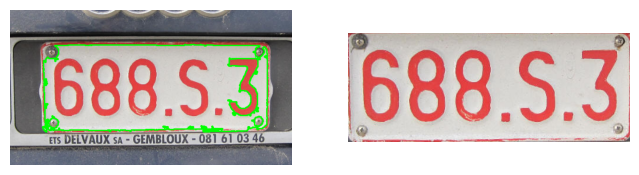

---DETECCIÓN DE NUMEROS---
Negro: 950.0   Blanco: 88810.0
Area Promedio 224.67723342939482


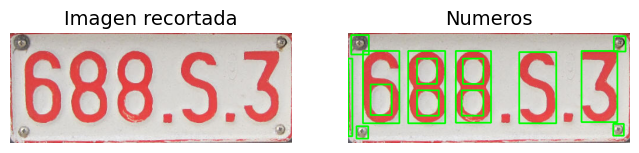

Filename: images76.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 412
Extend: 0.9445134575569358
Area: 66149.0
Area Imagen: 198000
Porcentaje de la placa: 0.3340858585858586


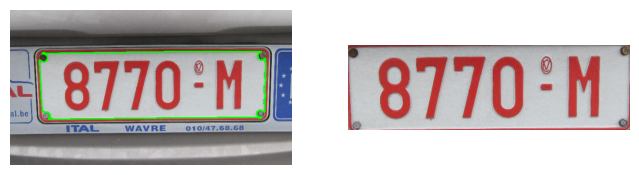

---DETECCIÓN DE NUMEROS---
Negro: 14350.0   Blanco: 55685.0
Area Promedio 555.2887700534759


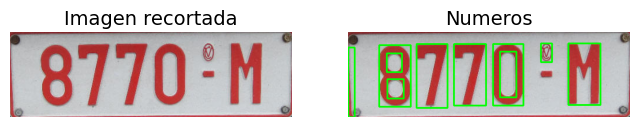

Filename: images77.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 874
Extend: 0.6785714285714286
Area: 47.5
Area Imagen: 198000
Porcentaje de la placa: 0.0002398989898989899


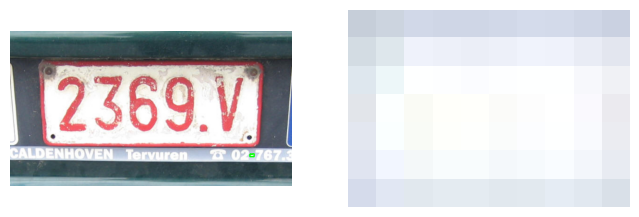

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 70.0
Area Promedio 4.0


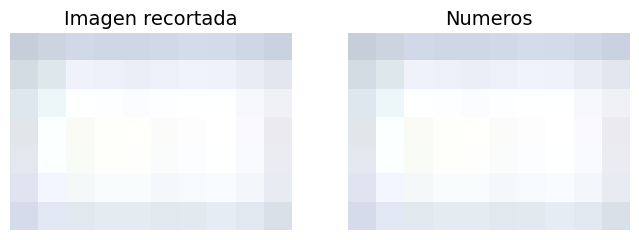

Filename: images78.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 328
Extend: 0.9583375467691374
Area: 28431.0
Area Imagen: 198000
Porcentaje de la placa: 0.1435909090909091


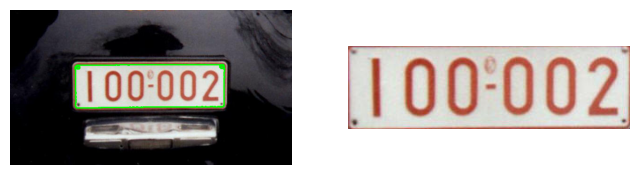

---DETECCIÓN DE NUMEROS---
Negro: 1002.0   Blanco: 28665.0
Area Promedio 3374.8636363636365


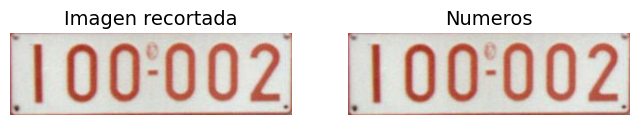

Filename: images79.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1210
Extend: 0.9478004205078441
Area: 58602.5
Area Imagen: 198000
Porcentaje de la placa: 0.29597222222222225


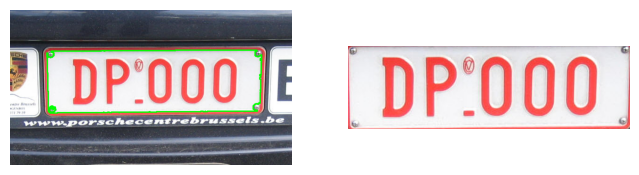

---DETECCIÓN DE NUMEROS---
Negro: 250.0   Blanco: 61580.0
Area Promedio 1740.111111111111


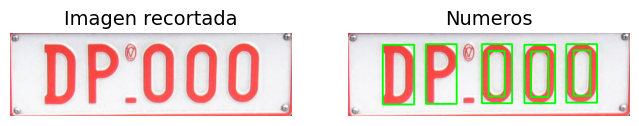

Filename: images8.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 415
Extend: 0.9473340139344115
Area: 52892.5
Area Imagen: 198000
Porcentaje de la placa: 0.26713383838383836


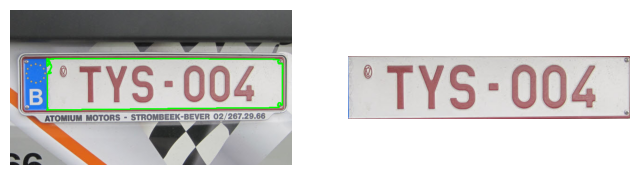

---DETECCIÓN DE NUMEROS---
Negro: 810.0   Blanco: 55023.0
Area Promedio 570.5942028985507


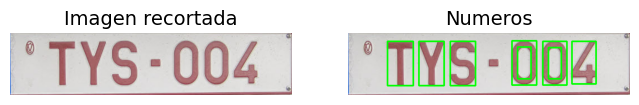

Filename: images80.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 988
Extend: 0.942208890189575
Area: 57951.5
Area Imagen: 198000
Porcentaje de la placa: 0.2926843434343434


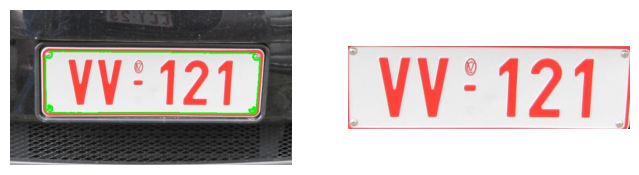

---DETECCIÓN DE NUMEROS---
Negro: 9.0   Blanco: 61497.0
Area Promedio 1881.9772727272727


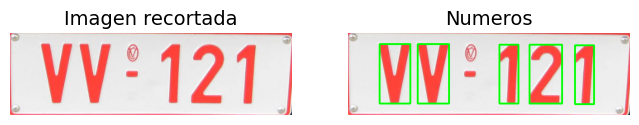

Filename: images81.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1659
Extend: 0.8439184029671648
Area: 38681.0
Area Imagen: 198000
Porcentaje de la placa: 0.19535858585858587


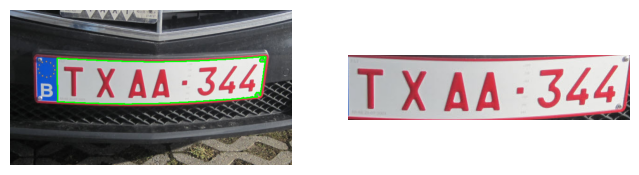

---DETECCIÓN DE NUMEROS---
Negro: 6550.0   Blanco: 39285.0
Area Promedio 404.1012658227848


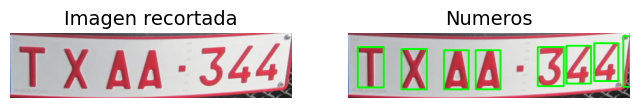

Filename: images82.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 590
Extend: 0.9333831624905087
Area: 39336.5
Area Imagen: 198000
Porcentaje de la placa: 0.1986691919191919


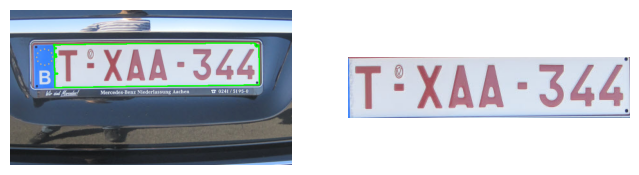

---DETECCIÓN DE NUMEROS---
Negro: 60.0   Blanco: 42084.0
Area Promedio 1555.945945945946


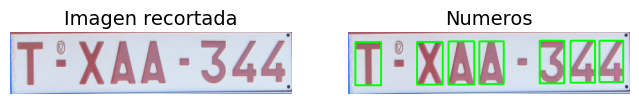

Filename: images83.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 487
Extend: 0.9615477874318044
Area: 47587.0
Area Imagen: 198000
Porcentaje de la placa: 0.24033838383838385


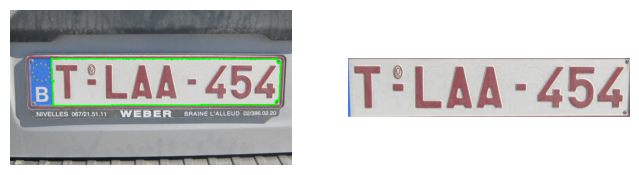

---DETECCIÓN DE NUMEROS---
Negro: 290.0   Blanco: 49200.0
Area Promedio 696.0802469135803


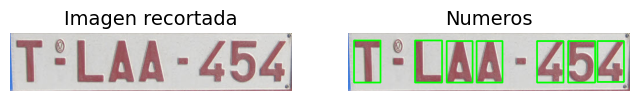

Filename: images84.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 368
Extend: 0.8629155794966754
Area: 51261.5
Area Imagen: 198000
Porcentaje de la placa: 0.25889646464646465


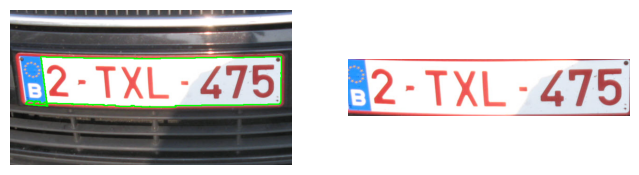

---DETECCIÓN DE NUMEROS---
Negro: 1998.0   Blanco: 57407.0
Area Promedio 1374.0819672131147


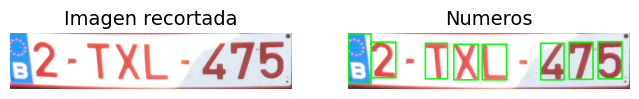

Filename: images85.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 91
Extend: 0.9614298394254821
Area: 47660.0
Area Imagen: 198000
Porcentaje de la placa: 0.2407070707070707


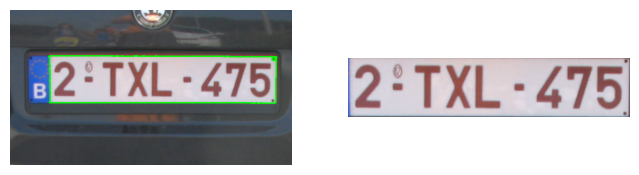

---DETECCIÓN DE NUMEROS---
Negro: 4918.0   Blanco: 44654.0
Area Promedio 6810.166666666667


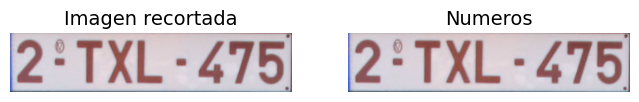

Filename: images86.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1045
Extend: 0.8244281524926687
Area: 42169.5
Area Imagen: 198000
Porcentaje de la placa: 0.21297727272727274


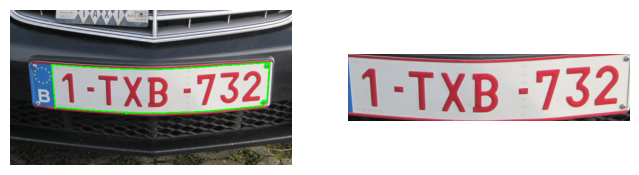

---DETECCIÓN DE NUMEROS---
Negro: 9291.0   Blanco: 41859.0
Area Promedio 600.4833333333333


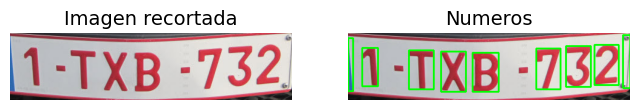

Filename: images87.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 565
Extend: 0.9649507119386638
Area: 35240.0
Area Imagen: 198000
Porcentaje de la placa: 0.177979797979798


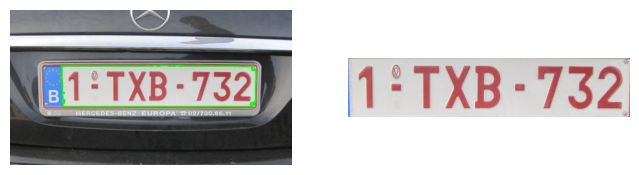

---DETECCIÓN DE NUMEROS---
Negro: 982.0   Blanco: 35538.0
Area Promedio 466.075


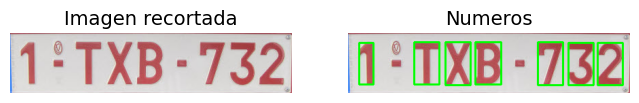

Filename: images88.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1475
Extend: 0.8124137931034483
Area: 589.0
Area Imagen: 198000
Porcentaje de la placa: 0.0029747474747474746


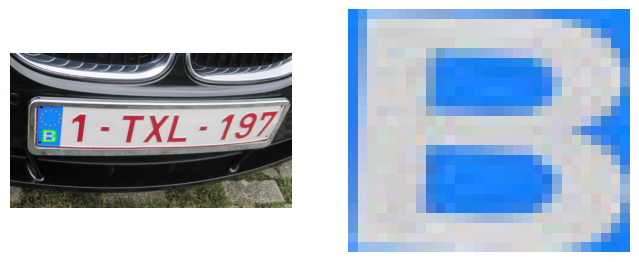

---DETECCIÓN DE NUMEROS---
Negro: 0.0   Blanco: 725.0
Area Promedio 74.0


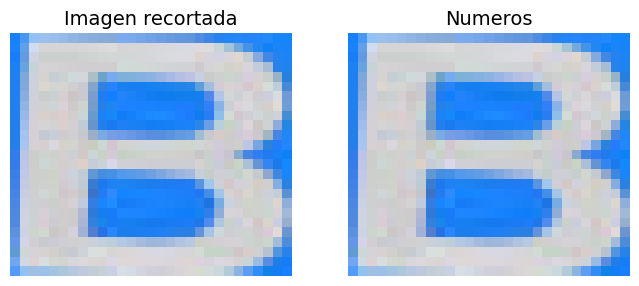

Filename: images89.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 351
Extend: 0.9442182729194395
Area: 48242.0
Area Imagen: 198000
Porcentaje de la placa: 0.24364646464646464


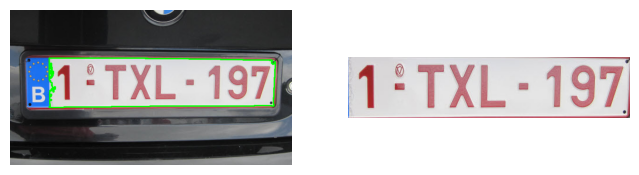

---DETECCIÓN DE NUMEROS---
Negro: 1287.0   Blanco: 49805.0
Area Promedio 929.2054794520548


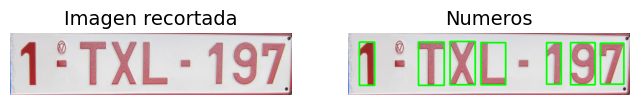

Filename: images9.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 309
Extend: 0.8508522727272727
Area: 1198.0
Area Imagen: 198000
Porcentaje de la placa: 0.00605050505050505


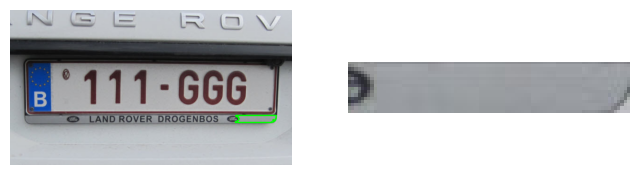

---DETECCIÓN DE NUMEROS---
Negro: 51.0   Blanco: 1357.0
Area Promedio 22.083333333333332


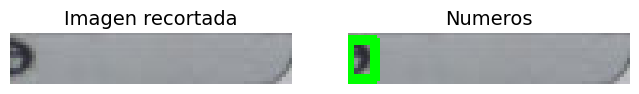

Filename: images90.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 713
Extend: 0.9639013617960986
Area: 65473.0
Area Imagen: 198000
Porcentaje de la placa: 0.33067171717171717


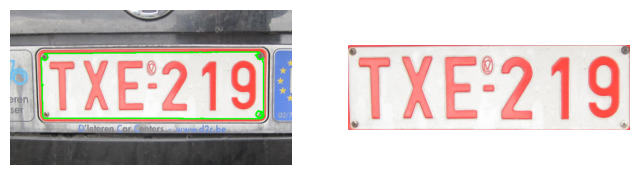

---DETECCIÓN DE NUMEROS---
Negro: 27.0   Blanco: 67898.0
Area Promedio 298.74545454545455


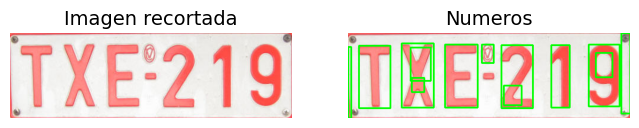

Filename: images91.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 2431
Extend: 0.9612455948984729
Area: 45824.5
Area Imagen: 198000
Porcentaje de la placa: 0.2314368686868687


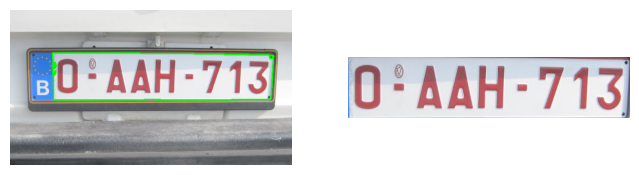

---DETECCIÓN DE NUMEROS---
Negro: 1255.0   Blanco: 46417.0
Area Promedio 1589.7906976744187


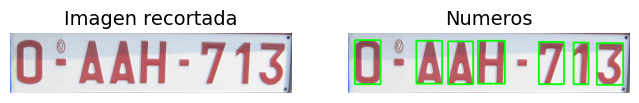

Filename: images92.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1239
Extend: 0.8313928335114775
Area: 65337.5
Area Imagen: 198000
Porcentaje de la placa: 0.32998737373737375


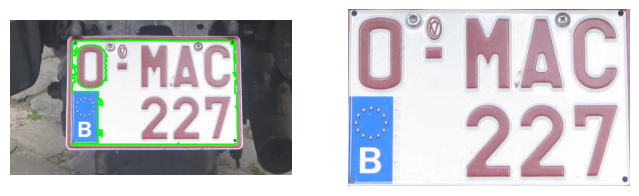

---DETECCIÓN DE NUMEROS---
Negro: 116.0   Blanco: 78472.0
Area Promedio 149.205


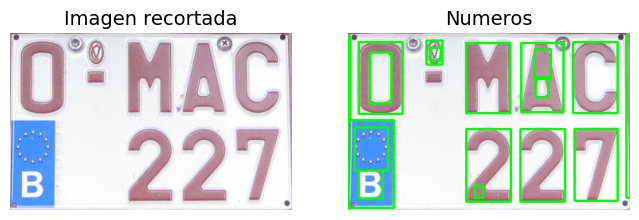

Filename: images93.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 812
Extend: 0.8622622791254867
Area: 46065.5
Area Imagen: 198000
Porcentaje de la placa: 0.2326540404040404


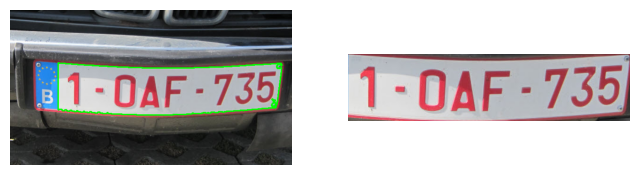

---DETECCIÓN DE NUMEROS---
Negro: 9443.0   Blanco: 43981.0
Area Promedio 457.5


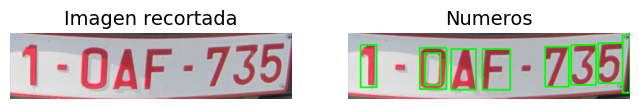

Filename: images94.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 337
Extend: 0.9561968710435883
Area: 42294.5
Area Imagen: 198000
Porcentaje de la placa: 0.21360858585858586


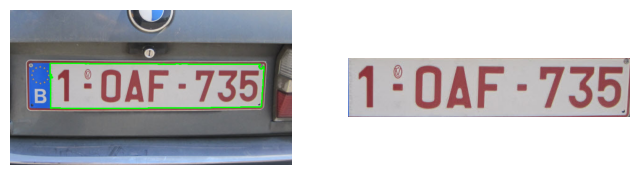

---DETECCIÓN DE NUMEROS---
Negro: 7902.0   Blanco: 36330.0
Area Promedio 1642.3902439024391


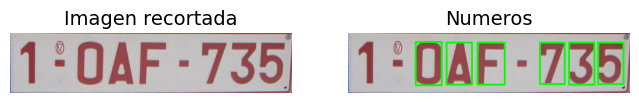

Filename: images95.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 1201
Extend: 0.8760254988913525
Area: 79017.5
Area Imagen: 198000
Porcentaje de la placa: 0.39907828282828284


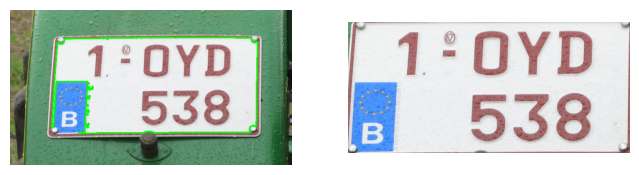

---DETECCIÓN DE NUMEROS---
Negro: 632.0   Blanco: 89568.0
Area Promedio 459.6845637583893


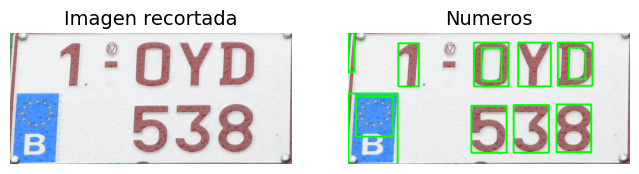

Filename: images96.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 866
Extend: 0.8840437749104911
Area: 52346.0
Area Imagen: 198000
Porcentaje de la placa: 0.26437373737373737


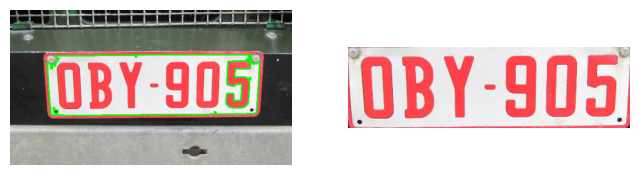

---DETECCIÓN DE NUMEROS---
Negro: 275.0   Blanco: 58937.0
Area Promedio 780.1111111111111


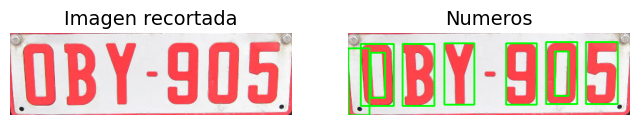

Filename: images97.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 979
Extend: 0.9670189907416185
Area: 61206.5
Area Imagen: 198000
Porcentaje de la placa: 0.3091237373737374


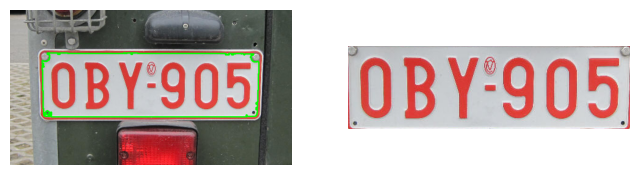

---DETECCIÓN DE NUMEROS---
Negro: 1254.0   Blanco: 62040.0
Area Promedio 531.5979381443299


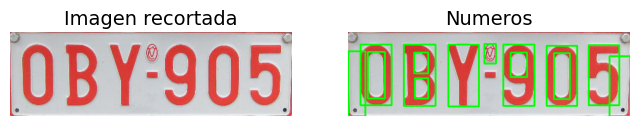

Filename: images98.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 19
Extend: 0.9435328282828283
Area: 186819.5
Area Imagen: 198000
Porcentaje de la placa: 0.9435328282828283


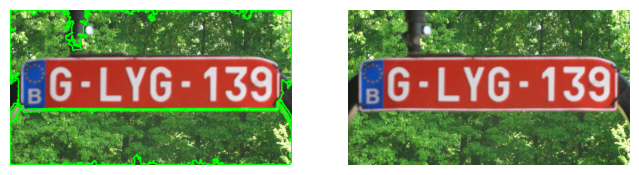

---DETECCIÓN DE NUMEROS---
Negro: 121596.0   Blanco: 76404.0
Area Promedio 197.6174370537392


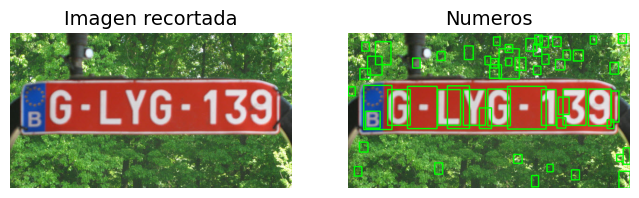

Filename: images99.jpg
---DETECCIÓN DE PLACA---
Cotorno más ajustado: 537
Extend: 0.8624222018161413
Area: 84526.0
Area Imagen: 198000
Porcentaje de la placa: 0.4268989898989899


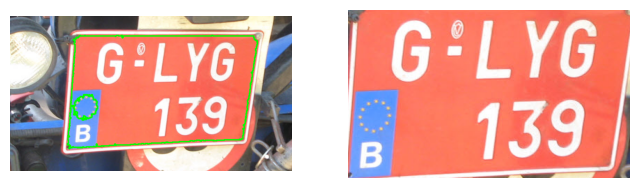

---DETECCIÓN DE NUMEROS---
Negro: 678.0   Blanco: 97332.0
Area Promedio 1032.547263681592


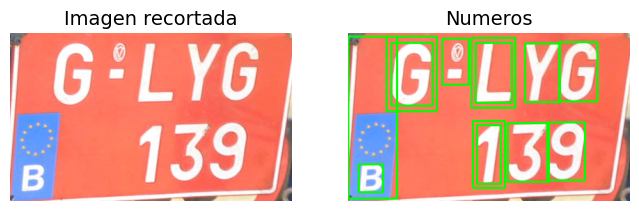

In [19]:
import os
rootdir = os.getcwd() + "\LicencePlates"
path = "LicencePlates/"

for filename in os.listdir(rootdir):
    print("Filename:", filename)
    find_numbers(path + filename)